In [4]:
# ============================================================================
# Create Calibration Files from Flat Field Sequences
# ============================================================================
# Based on ESO Eclipse "flat" algorithm:
# - Fits linear regression per pixel across multiple flat exposures
# - Extracts: gain map (flat), intercept map (thermal), bad pixel map
#
# Input: Multiple flat fields with varying illumination levels
# Output: master_flat, intercept_map, bad_pixel_map (per filter/dither)

import numpy as np
import glob
import os
from astropy.io import fits
from astropy.stats import sigma_clip
from scipy import stats
import matplotlib.pyplot as plt
from collections import defaultdict

# ============================================================================
# CONFIGURATION
# ============================================================================

# Input folder with flat fields (can span multiple nights)
FLAT_FOLDERS = None

# Or use a pattern
FLAT_PATTERN = "../../../../../GRB/REM/process_REMIR/flat/feb/**/*fits"
#FLAT_PATTERN = "/path/to/data/**/*.fits"  # ** means recursive
# Output folder for cubes and calibration files
OUTPUT_FOLDER = "./calibration_feb/"
CUBE_FOLDER = "./flat_cubes_feb/"  # Subfolder for data cubes

# Grouping keywords
FILTER_KEY = "FILTER"
old = False

if old:
    # because they dont have the dither wedge position
    DITHER_KEY = "DITHID"
else:
    DITHER_KEY = "DITHANGL"

# Algorithm parameters
MIN_FLATS = 5
GAIN_MIN = 0.5
GAIN_MAX = 2.0
SIGMA_CLIP_RESIDUALS = 3.0
USE_PROPORTIONAL_FIT = False
NORMALIZE_GAIN = True

# Algorithm parameters
SMOOTH_INTERCEPT = False      # Apply spatial smoothing to intercept map
SMOOTH_SCALE = 20            # Smoothing scale in pixels (typical: 10-30)
ENFORCE_POSITIVE = False      # Clip negative intercepts to zero

In [5]:
def load_flat_files(folders=None, pattern=None):
    """
    Load all flat files and group by filter + dither position.
    
    Returns:
        dict: {(filter, dither_angle): [(filepath, data, median_flux, header), ...]}
    """
    files = []
    
    if pattern:
        files = glob.glob(pattern, recursive=True)
    elif folders:
        for folder in folders:
            files.extend(glob.glob(os.path.join(folder, "*.fits")))
            files.extend(glob.glob(os.path.join(folder, "*.fits.gz")))
    
    print(f"Found {len(files)} FITS files")
    
    # Group by filter and dither angle
    groups = defaultdict(list)
    
    for filepath in files:
        try:
            with fits.open(filepath) as hdul:
                header = hdul[0].header
                data = hdul[0].data.astype(np.float64)
                
                # Get grouping keys
                filt = header.get(FILTER_KEY, "UNKNOWN")
                
                # Try both old and new dither keywords
                dither = header.get(DITHER_KEY)
                #if dither is None:
                #    dither = header.get("DITHANGL", 0)
                
                # Round dither angle to avoid floating point issues
                dither = round(float(dither), 1)
                
                # Compute robust median flux (central region, sigma-clipped)
                vals = data[np.isfinite(data)].ravel()
                p10, p90 = np.percentile(vals, [10, 90])
                central_vals = vals[(vals >= p10) & (vals <= p90)]
                clipped = sigma_clip(central_vals, sigma=3, cenfunc='median')
                median_flux = np.median(clipped.data[~clipped.mask])
                
                if median_flux > 0:  # Skip empty/bad frames
                    groups[(filt, dither)].append({
                        'filepath': filepath,
                        'data': data,
                        'median_flux': median_flux,
                        'header': header
                    })
                    print(f"  Loaded: {os.path.basename(filepath)} | {filt} | dither={dither} | median={median_flux:.1f}")
                    
        except Exception as e:
            print(f"  Error loading {filepath}: {e}")
    
    return groups

In [6]:
# ============================================================================
# PART 1: Create Data Cubes (for visualization/inspection)
# ============================================================================

print("=" * 80)
print("PART 1: Creating Data Cubes")
print("=" * 80)

# Load all flats
print("Loading flat files...")
flat_groups = load_flat_files(pattern=FLAT_PATTERN)

print(f"\nFound {len(flat_groups)} unique (filter, dither) combinations:")
for key, group in flat_groups.items():
    print(f"  {key}: {len(group)} frames")

# Create output folder for cubes
os.makedirs(CUBE_FOLDER, exist_ok=True)

# Save cubes for each (filter, dither) combination
for (filt, dither), group in flat_groups.items():
    if (dither != 98) & (dither != 98):
        print(f"\nProcessing: {filt} dither={dither} ({len(group)} frames)")
    
        # Sort by illumination level
        group_sorted = sorted(group, key=lambda x: x['median_flux'])
    
        # Stack data
        n_frames = len(group_sorted)
        shape = group_sorted[0]['data'].shape
    
        data_cube = np.zeros((n_frames, shape[0], shape[1]), dtype=np.float32)
        illumination_levels = np.zeros(n_frames, dtype=np.float32)
    
        for i, frame in enumerate(group_sorted):
            data_cube[i, :, :] = frame['data']
            illumination_levels[i] = frame['median_flux']
    
        # Save cube as FITS file
        if old:
            cube_filename = os.path.join(CUBE_FOLDER, f"{filt}_dither{dither*72-72:.0f}_cube.fits")
        else:
            cube_filename = os.path.join(CUBE_FOLDER, f"{filt}_dither{dither:.0f}_cube.fits")
    
        hdu_data = fits.PrimaryHDU(data_cube)
        hdu_data.header['FILTER'] = filt
        if old:
            hdu_data.header['DITHER'] = dither*72-72
        else:  
            hdu_data.header['DITHER'] = dither
            
        hdu_data.header['NFRAMES'] = n_frames
        hdu_data.header['BUNIT'] = 'ADU'
        hdu_data.header['COMMENT'] = 'Data cube: [frame, y, x]'
    
        # Save illumination levels as table extension
        hdu_table = fits.BinTableHDU.from_columns([
            fits.Column(name='FRAME', format='I', array=np.arange(n_frames)),
            fits.Column(name='MEDIAN_FLUX', format='E', array=illumination_levels)
        ])
        hdu_table.header['EXTNAME'] = 'ILLUMINATION'
    
        hdul = fits.HDUList([hdu_data, hdu_table])
        hdul.writeto(cube_filename, overwrite=True)
    
        print(f"  Saved cube: {cube_filename}")
        print(f"  Shape: {data_cube.shape}")
        print(f"  Illumination range: {illumination_levels.min():.1f} - {illumination_levels.max():.1f} ADU")

print("\n" + "=" * 80)
print(f"Data cubes saved to: {CUBE_FOLDER}")
print("You can now inspect pixel responses vs illumination!")

PART 1: Creating Data Cubes
Loading flat files...
Found 614 FITS files
  Loaded: Flat_10_5_H2_1.fits | H2 | dither=0.0 | median=9617.0
  Loaded: Flat_9_5_Z_1.fits | Z | dither=0.0 | median=2879.0
  Loaded: Flat_8_5_J_3.fits | J | dither=144.0 | median=1109.0
  Loaded: Flat_8_5_J_2.fits | J | dither=72.0 | median=1136.0
  Loaded: Flat_8_5_J_5.fits | J | dither=288.0 | median=1055.0
  Loaded: Flat_8_5_J_4.fits | J | dither=216.0 | median=1085.0
  Loaded: Flat_9_5_Z_5.fits | Z | dither=288.0 | median=2683.0
  Loaded: Flat_10_5_H2_5.fits | H2 | dither=288.0 | median=9438.0
  Loaded: Flat_10_5_H2_4.fits | H2 | dither=216.0 | median=9488.0
  Loaded: Flat_9_5_Z_4.fits | Z | dither=216.0 | median=2739.0
  Loaded: Flat_8_5_J_1.fits | J | dither=0.0 | median=1164.0
  Loaded: Flat_9_5_Z_3.fits | Z | dither=144.0 | median=2779.0
  Loaded: Flat_10_5_H2_3.fits | H2 | dither=144.0 | median=9580.0
  Loaded: Flat_10_5_H2_2.fits | H2 | dither=72.0 | median=9593.0
  Loaded: Flat_9_5_Z_2.fits | Z | dither

  Loaded: Flat_9_5_Z_5.fits | Z | dither=288.0 | median=3458.0
  Loaded: Flat_2_5_H_1.fits | H | dither=0.0 | median=9011.0
  Loaded: Flat_10_5_H2_5.fits | H2 | dither=288.0 | median=7923.0
  Loaded: Flat_5_5_H2_3.fits | H2 | dither=144.0 | median=9465.0
  Loaded: Flat_4_5_Z_5.fits | Z | dither=288.0 | median=9213.0
  Loaded: Flat_4_5_Z_4.fits | Z | dither=216.0 | median=9705.0
  Loaded: Flat_5_5_H2_2.fits | H2 | dither=72.0 | median=9553.0
  Loaded: Flat_10_5_H2_4.fits | H2 | dither=216.0 | median=7956.0
  Loaded: Flat_9_5_Z_4.fits | Z | dither=216.0 | median=3581.0
  Loaded: Flat_6_5_K_1.fits | K | dither=0.0 | median=4677.0
  Loaded: Flat_3_5_J_4.fits | J | dither=216.0 | median=5053.0
  Loaded: Flat_7_5_H_1.fits | H | dither=0.0 | median=3114.0
  Loaded: Flat_5_5_H2_5.fits | H2 | dither=288.0 | median=9211.0
  Loaded: Flat_1_5_K_1.fits | K | dither=0.0 | median=11902.0
  Loaded: Flat_4_5_Z_3.fits | Z | dither=144.0 | median=10132.0
  Loaded: Flat_8_5_J_1.fits | J | dither=0.0 | med

  Loaded: Flat_6_5_K_5.fits | K | dither=288.0 | median=5465.0
  Loaded: Flat_2_5_H_4.fits | H | dither=216.0 | median=5809.0
  Loaded: Flat_1_5_K_2.fits | K | dither=72.0 | median=6682.0
  Loaded: Flat_2_5_H_3.fits | H | dither=144.0 | median=6227.0
  Loaded: Flat_6_5_K_2.fits | K | dither=72.0 | median=5523.0
  Loaded: Flat_8_5_J_5.fits | J | dither=288.0 | median=1317.0
  Loaded: Flat_7_5_H_2.fits | H | dither=72.0 | median=1487.0
  Loaded: Flat_1_5_K_5.fits | K | dither=288.0 | median=6335.0
  Loaded: Flat_5_5_H2_1.fits | H2 | dither=0.0 | median=11076.0
  Loaded: Flat_1_5_K_4.fits | K | dither=216.0 | median=6449.0
  Loaded: Flat_7_5_H_3.fits | H | dither=144.0 | median=1464.0
  Loaded: Flat_8_5_J_4.fits | J | dither=216.0 | median=1347.0
  Loaded: Flat_6_5_K_3.fits | K | dither=144.0 | median=5517.0
  Loaded: Flat_2_5_H_2.fits | H | dither=72.0 | median=6733.0
  Loaded: Flat_3_5_J_5.fits | J | dither=288.0 | median=3625.0
  Loaded: Flat_9_5_Z_5.fits | Z | dither=288.0 | median=27

  Loaded: Flat_10_5_H2_2.fits | H2 | dither=72.0 | median=9186.0
  Loaded: Flat_9_5_Z_2.fits | Z | dither=72.0 | median=2649.0
  Loaded: Flat_3_5_J_2.fits | J | dither=72.0 | median=3712.0
  Loaded: Flat_4_5_Z_2.fits | Z | dither=72.0 | median=6745.0
  Loaded: Flat_5_5_H2_4.fits | H2 | dither=216.0 | median=11123.0
  Loaded: Flat_4_5_Z_1.fits | Z | dither=0.0 | median=3332.0
  Loaded: Flat_1_5_K_3.fits | K | dither=144.0 | median=5614.0
  Loaded: Flat_10_5_H2_1.fits | H2 | dither=0.0 | median=9261.0
  Loaded: Flat_9_5_Z_1.fits | Z | dither=0.0 | median=2065.0
  Loaded: Flat_2_5_H_5.fits | H | dither=288.0 | median=1717.0
  Loaded: Flat_6_5_K_4.fits | K | dither=216.0 | median=5472.0
  Loaded: Flat_3_5_J_1.fits | J | dither=0.0 | median=1441.0
  Loaded: Flat_8_5_J_3.fits | J | dither=144.0 | median=710.0
  Loaded: Flat_7_5_H_4.fits | H | dither=216.0 | median=1265.0
  Loaded: Flat_7_5_H_5.fits | H | dither=288.0 | median=1251.0
  Loaded: Flat_8_5_J_2.fits | J | dither=72.0 | median=723.

  Loaded: Flat_9_5_Z_5.fits | Z | dither=288.0 | median=1673.0
  Loaded: Flat_2_5_H_1.fits | H | dither=0.0 | median=1390.0
  Loaded: Flat_10_5_H2_5.fits | H2 | dither=288.0 | median=9188.0
  Loaded: Flat_5_5_H2_3.fits | H2 | dither=144.0 | median=9438.0
  Loaded: Flat_4_5_Z_5.fits | Z | dither=288.0 | median=2023.0
  Loaded: Flat_4_5_Z_4.fits | Z | dither=216.0 | median=2085.0
  Loaded: Flat_5_5_H2_2.fits | H2 | dither=72.0 | median=9420.0
  Loaded: Flat_10_5_H2_4.fits | H2 | dither=216.0 | median=9223.0
  Loaded: Flat_9_5_Z_4.fits | Z | dither=216.0 | median=1691.0
  Loaded: Flat_6_5_K_1.fits | K | dither=0.0 | median=5294.0
  Loaded: Flat_3_5_J_4.fits | J | dither=216.0 | median=744.0
  Loaded: Flat_7_5_H_1.fits | H | dither=0.0 | median=1310.0
  Loaded: Flat_5_5_H2_5.fits | H2 | dither=288.0 | median=9334.0
  Loaded: Flat_1_5_K_1.fits | K | dither=0.0 | median=5318.0
  Loaded: Flat_4_5_Z_3.fits | Z | dither=144.0 | median=2138.0
  Loaded: Flat_8_5_J_1.fits | J | dither=0.0 | median

In [7]:
def robust_linear_fit_pixel(y_values, x_values, sigma=3.0):
    """
    Robust linear fit for a single pixel's time series.
    Uses iterative sigma clipping to reject outliers (stars, cosmic rays).
    
    Args:
        y_values: Pixel values across frames
        x_values: Median flux of each frame (illumination proxy)
        sigma: Sigma clipping threshold
    
    Returns:
        slope, intercept, residual_error, n_used
    """
    mask = np.isfinite(y_values) & np.isfinite(x_values)
    y = y_values[mask]
    x = x_values[mask]
    
    if len(x) < 3:
        return np.nan, np.nan, np.nan, 0
    
    # Iterative sigma-clipped linear fit
    for _ in range(5):  # Max 5 iterations
        if len(x) < 3:
            break
            
        # Fit line
        slope, intercept, r_value, p_value, std_err = stats.linregress(x, y)
        
        # Compute residuals
        predicted = slope * x + intercept
        residuals = y - predicted
        
        # Sigma clip
        clipped = sigma_clip(residuals, sigma=sigma, masked=True)
        good = ~clipped.mask
        
        if np.sum(good) == len(x):  # No more outliers
            break
            
        x = x[good]
        y = y[good]
    
    if len(x) < 3:
        return np.nan, np.nan, np.nan, 0
    
    # Final fit
    slope, intercept, r_value, p_value, std_err = stats.linregress(x, y)
    
    # Residual sum of squares
    predicted = slope * x + intercept
    residuals = y - predicted
    rss = np.sum(residuals**2) / (len(x) - 2)  # Variance of residuals
    
    return slope, intercept, np.sqrt(rss), len(x)


def proportional_fit_pixel(y_values, x_values, sigma=3.0):
    """
    Proportional fit (y = ax, no intercept) using median of y/x ratios.
    More robust when dark subtraction has been applied.
    
    Returns:
        slope, 0.0 (intercept), residual_error, n_used
    """
    mask = np.isfinite(y_values) & np.isfinite(x_values) & (x_values > 0)
    y = y_values[mask]
    x = x_values[mask]
    
    if len(x) < 3:
        return np.nan, 0.0, np.nan, 0
    
    # Compute all y/x ratios
    ratios = y / x
    
    # Sigma clip the ratios
    clipped = sigma_clip(ratios, sigma=sigma, masked=True)
    good_ratios = ratios[~clipped.mask]
    
    if len(good_ratios) < 2:
        return np.nan, 0.0, np.nan, 0
    
    # Median ratio is the slope
    slope = np.median(good_ratios)
    
    # Residual error
    predicted = slope * x[~clipped.mask]
    residuals = y[~clipped.mask] - predicted
    rss = np.sum(residuals**2) / max(len(good_ratios) - 1, 1)
    
    return slope, 0.0, np.sqrt(rss), len(good_ratios)


def create_calibration_maps(flat_group, use_proportional=False, 
                           smooth_intercept=True, smooth_scale=20, 
                           enforce_positive_intercept=True):
    """
    Create gain, intercept, and bad pixel maps from a group of flats.
    
    Args:
        flat_group: List of dicts with 'data' and 'median_flux'
        use_proportional: If True, fit y=ax instead of y=ax+b
        smooth_intercept: Apply spatial smoothing to intercept map
        smooth_scale: Smoothing scale in pixels (median filter size)
        enforce_positive_intercept: Clip negative intercepts to zero
    
    Returns:
        gain_map, intercept_map, badpix_map, n_frames_used
    """
    n_frames = len(flat_group)
    
    if n_frames < MIN_FLATS:
        print(f"  Warning: Only {n_frames} flats, need at least {MIN_FLATS}")
        return None, None, None, 0
    
    # Sort by illumination level
    flat_group = sorted(flat_group, key=lambda x: x['median_flux'])
    
    # Get shape from first frame
    shape = flat_group[0]['data'].shape
    
    # Stack all data and illumination values
    data_stack = np.array([f['data'] for f in flat_group])  # (N, Y, X)
    median_fluxes = np.array([f['median_flux'] for f in flat_group])  # (N,)
    
    print(f"  Illumination range: {median_fluxes.min():.1f} - {median_fluxes.max():.1f} ADU")
    print(f"  Processing {shape[0]} x {shape[1]} pixels...")
    
    # Output maps
    gain_map = np.zeros(shape, dtype=np.float64)
    intercept_map = np.zeros(shape, dtype=np.float64)
    n_used_map = np.zeros(shape, dtype=np.int16)
    
    # Fit each pixel
    fit_func = proportional_fit_pixel if use_proportional else robust_linear_fit_pixel
    
    for i in range(shape[0]):
        if i % 100 == 0:
            print(f"    Row {i}/{shape[0]}")
        for j in range(shape[1]):
            pixel_values = data_stack[:, i, j]
            slope, intercept, error, n_used = fit_func(
                pixel_values, median_fluxes, sigma=SIGMA_CLIP_RESIDUALS
            )
            gain_map[i, j] = slope
            intercept_map[i, j] = intercept
            n_used_map[i, j] = n_used
    
    # ========================================================================
    # SMOOTH INTERCEPT MAP (assumes thermal pattern on ~10s of pixels scale)
    # ========================================================================
    if smooth_intercept and not use_proportional:
        from scipy.ndimage import median_filter, gaussian_filter
        
        print(f"  Smoothing intercept map (scale={smooth_scale} px)...")
        
        # Create mask for valid pixels (good fits only)
        valid_mask = np.isfinite(intercept_map) & (n_used_map >= 3)
        
        # Replace invalid with local median before smoothing
        intercept_smooth = intercept_map.copy()
        if np.any(~valid_mask):
            # Fill invalid pixels with median of valid neighbors
            intercept_smooth[~valid_mask] = np.nanmedian(intercept_map[valid_mask])
        
        # Apply median filter (more robust to outliers than Gaussian)
        # Use size = 2*smooth_scale+1 to get effective smoothing at smooth_scale
        kernel_size = int(2 * smooth_scale + 1)
        if kernel_size % 2 == 0:  # Ensure odd size
            kernel_size += 1
        
        intercept_smooth = median_filter(intercept_smooth, size=kernel_size)
        
        # Optional: additional Gaussian smoothing for extra smoothness
        # intercept_smooth = gaussian_filter(intercept_smooth, sigma=smooth_scale/2)
        
        # Restore original values at invalid pixels (don't smooth bad fits)
        intercept_smooth[~valid_mask] = intercept_map[~valid_mask]
        
        intercept_map = intercept_smooth
        print(f"    Intercept range after smoothing: [{np.nanmin(intercept_map):.1f}, {np.nanmax(intercept_map):.1f}] ADU")
    
    # ========================================================================
    # ENFORCE NON-NEGATIVE INTERCEPT (thermal offset can't be negative)
    # ========================================================================
    if enforce_positive_intercept and not use_proportional:
        n_negative = np.sum(intercept_map < 0)
        if n_negative > 0:
            print(f"  Clipping {n_negative} negative intercepts to zero ({100*n_negative/intercept_map.size:.2f}%)")
            intercept_map = np.maximum(intercept_map, 0.0)
    
    # Normalize gain map so median = 1
    if NORMALIZE_GAIN:
        median_gain = np.nanmedian(gain_map)
        if median_gain > 0:
            gain_map = gain_map / median_gain
            print(f"  Normalized gain map (median was {median_gain:.4f})")
    
    # Create bad pixel map (0 = bad, 1 = good)
    badpix_map = np.ones(shape, dtype=np.uint8)
    badpix_map[gain_map < GAIN_MIN] = 0
    badpix_map[gain_map > GAIN_MAX] = 0
    badpix_map[~np.isfinite(gain_map)] = 0
    badpix_map[n_used_map < 3] = 0  # Not enough points for reliable fit
    
    n_bad = np.sum(badpix_map == 0)
    print(f"  Bad pixels: {n_bad} ({100*n_bad/badpix_map.size:.2f}%)")
    
    return gain_map, intercept_map, badpix_map, n_frames

In [8]:
def save_calibration_files(gain, intercept, badpix, filt, dither, 
                           n_frames, output_folder, ref_header=None):
    """
    Save all calibration products as FITS files.
    """
    os.makedirs(output_folder, exist_ok=True)
    
    if old:
        base = f"{filt}_dither{dither*72-72:.0f}"
    else:
        base = f"{filt}_dither{dither:.0f}"
    
    # Common header keywords
    def add_header_info(hdu, product_name):
        hdu.header['FILTER'] = filt
        if old:
            hdu.header['DITHER'] = dither
        else:
            hdu.header['DITHER'] = dither*72-72
        hdu.header['NFRAMES'] = n_frames
        hdu.header['PRODUCT'] = product_name
        hdu.header['GAINMIN'] = GAIN_MIN
        hdu.header['GAINMAX'] = GAIN_MAX
        hdu.header['SIGCLIP'] = SIGMA_CLIP_RESIDUALS
        hdu.header['PROPFIT'] = USE_PROPORTIONAL_FIT
        if ref_header:
            for key in ['INSTRUME', 'TELESCOP', 'DETECTOR']:
                if key in ref_header:
                    hdu.header[key] = ref_header[key]
    
    # Gain map (flat field)
    hdu = fits.PrimaryHDU(gain.astype(np.float32))
    add_header_info(hdu, 'GAIN_MAP')
    hdu.header['BUNIT'] = 'relative gain'
    hdu.writeto(os.path.join(output_folder, f"{base}_flat.fits"), overwrite=True)
    
    # Intercept map (thermal/dark component)
    if intercept is not None and not USE_PROPORTIONAL_FIT:
        hdu = fits.PrimaryHDU(intercept.astype(np.float32))
        add_header_info(hdu, 'INTERCEPT_MAP')
        hdu.header['BUNIT'] = 'ADU'
        hdu.writeto(os.path.join(output_folder, f"{base}_intercept.fits"), overwrite=True)

    # Bad pixel map
    hdu = fits.PrimaryHDU(badpix.astype(np.uint8))
    add_header_info(hdu, 'BADPIX_MAP')
    hdu.header['BUNIT'] = 'mask'
    hdu.header['MASKCONV'] = '0=bad, 1=good'
    hdu.writeto(os.path.join(output_folder, f"{base}_badpix.fits"), overwrite=True)
    
    print(f"  Saved: {base}_flat.fits, {base}_intercept.fits, {base}_badpix.fits")


def plot_diagnostics(gain, intercept, badpix, filt, dither, output_folder):
    """
    Create diagnostic plots for quality assessment.
    """
    fig, axes = plt.subplots(2, 2, figsize=(12, 10))
    
    # Gain map
    ax = axes[0, 0]
    im = ax.imshow(gain, origin='lower', cmap='viridis', vmin=0.8, vmax=1.2)
    ax.set_title('Gain Map (Flat Field)')
    plt.colorbar(im, ax=ax, label='Relative Gain')
    
    # Gain histogram
    ax = axes[0, 1]
    valid_gain = gain[np.isfinite(gain)].flatten()
    ax.hist(valid_gain, bins=100, range=(0.5, 1.5), alpha=0.7)
    ax.axvline(1.0, color='r', linestyle='--', label='Unity')
    ax.axvline(GAIN_MIN, color='orange', linestyle=':', label=f'Bad < {GAIN_MIN}')
    ax.axvline(GAIN_MAX, color='orange', linestyle=':', label=f'Bad > {GAIN_MAX}')
    ax.set_xlabel('Gain')
    ax.set_ylabel('N pixels')
    ax.set_title('Gain Distribution')
    ax.legend()
    
    # Intercept map
    ax = axes[1, 0]
    if intercept is not None and not USE_PROPORTIONAL_FIT:
        vmin, vmax = np.nanpercentile(intercept, [5, 95])
        im = ax.imshow(intercept, origin='lower', cmap='RdBu_r', vmin=vmin, vmax=vmax)
        ax.set_title('Intercept Map (Thermal/Offset)')
        plt.colorbar(im, ax=ax, label='ADU')
    else:
        ax.text(0.5, 0.5, 'Proportional fit\n(no intercept)', 
                ha='center', va='center', transform=ax.transAxes)
        ax.set_title('Intercept Map')
    
    # Bad pixel map
    ax = axes[1, 1]
    ax.imshow(badpix, origin='lower', cmap='gray', vmin=0, vmax=1)
    n_bad = np.sum(badpix == 0)
    ax.set_title(f'Bad Pixel Map ({n_bad} bad, {100*n_bad/badpix.size:.2f}%)')
    
    plt.suptitle(f'Calibration Diagnostics: {filt} dither={dither}', fontsize=14)
    plt.tight_layout()
    plt.savefig(os.path.join(output_folder, f'{filt}_dither{dither:.0f}_diagnostics.png'), 
                dpi=150, bbox_inches='tight')
    plt.show()

PART 2: Creating Calibration Maps
Algorithm: Full linear (y=ax+b)
Gain thresholds: [0.5, 2.0]
Sigma clipping: 3.0



Processing: H2 dither=0.0 (25 frames)
  Illumination range: 7996.0 - 12139.0 ADU
  Processing 512 x 512 pixels...
    Row 0/512
    Row 100/512
    Row 200/512
    Row 300/512
    Row 400/512
    Row 500/512
  Normalized gain map (median was 0.9949)
  Bad pixels: 3519 (1.34%)
  Saved: H2_dither0_flat.fits, H2_dither0_intercept.fits, H2_dither0_badpix.fits


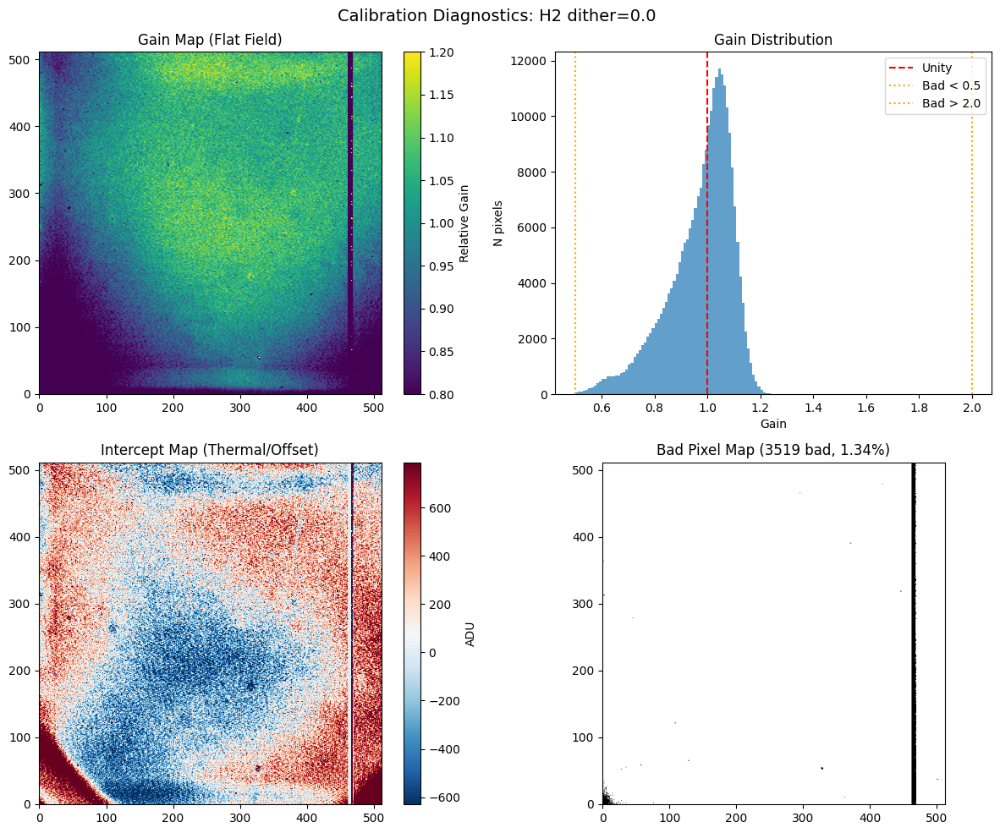


Processing: Z dither=0.0 (25 frames)
  Illumination range: 1703.0 - 11213.0 ADU
  Processing 512 x 512 pixels...
    Row 0/512
    Row 100/512
    Row 200/512
    Row 300/512
    Row 400/512
    Row 500/512
  Normalized gain map (median was 1.0004)
  Bad pixels: 3735 (1.42%)
  Saved: Z_dither0_flat.fits, Z_dither0_intercept.fits, Z_dither0_badpix.fits


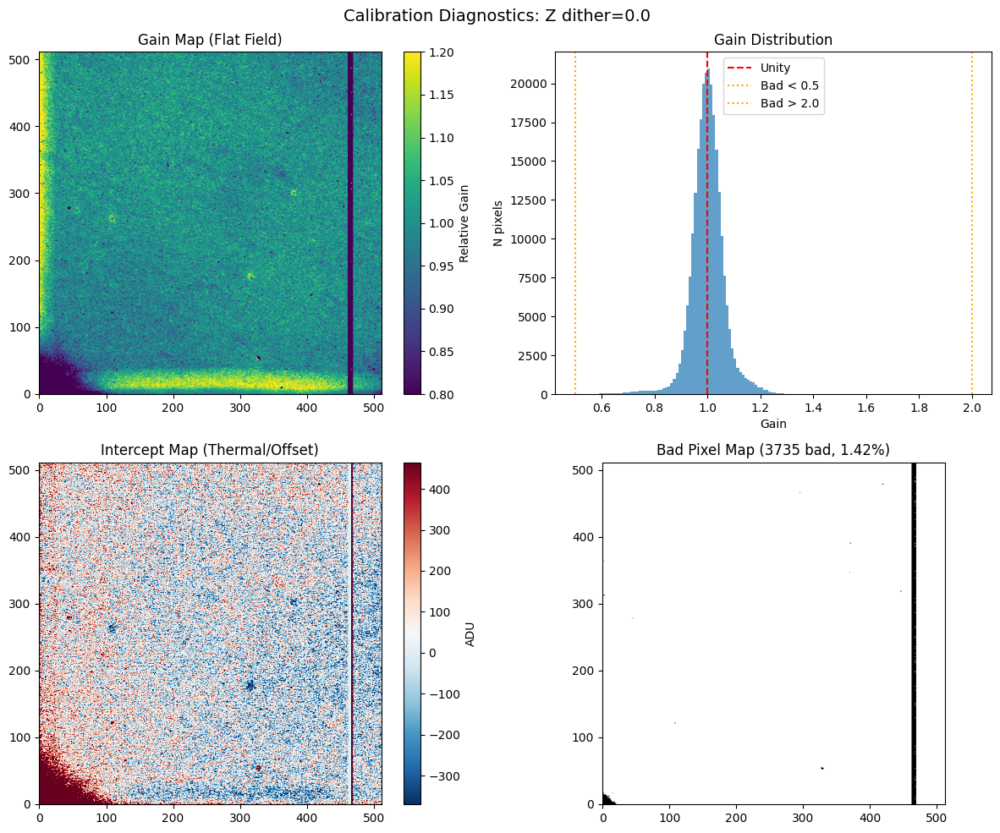


Processing: J dither=144.0 (25 frames)
  Illumination range: 522.0 - 5996.0 ADU
  Processing 512 x 512 pixels...
    Row 0/512
    Row 100/512
    Row 200/512
    Row 300/512
    Row 400/512
    Row 500/512
  Normalized gain map (median was 1.0010)
  Bad pixels: 3622 (1.38%)
  Saved: J_dither144_flat.fits, J_dither144_intercept.fits, J_dither144_badpix.fits


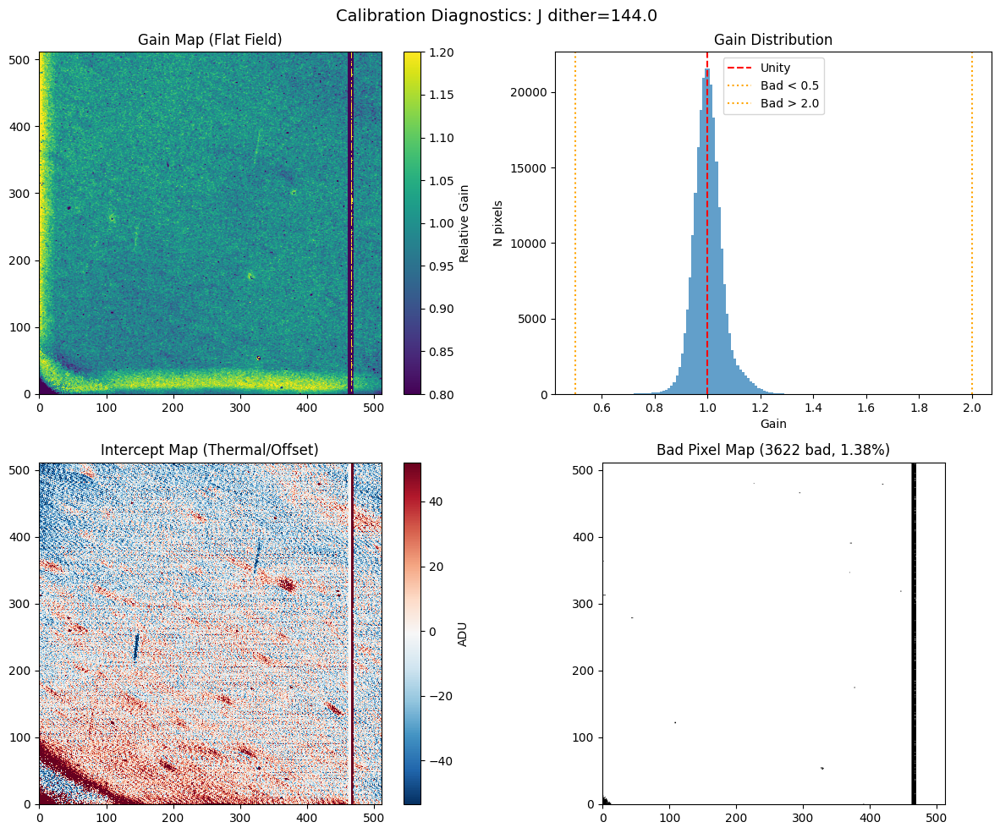


Processing: J dither=72.0 (25 frames)
  Illumination range: 522.0 - 6324.0 ADU
  Processing 512 x 512 pixels...
    Row 0/512
    Row 100/512
    Row 200/512
    Row 300/512
    Row 400/512
    Row 500/512
  Normalized gain map (median was 1.0010)
  Bad pixels: 3604 (1.37%)
  Saved: J_dither72_flat.fits, J_dither72_intercept.fits, J_dither72_badpix.fits


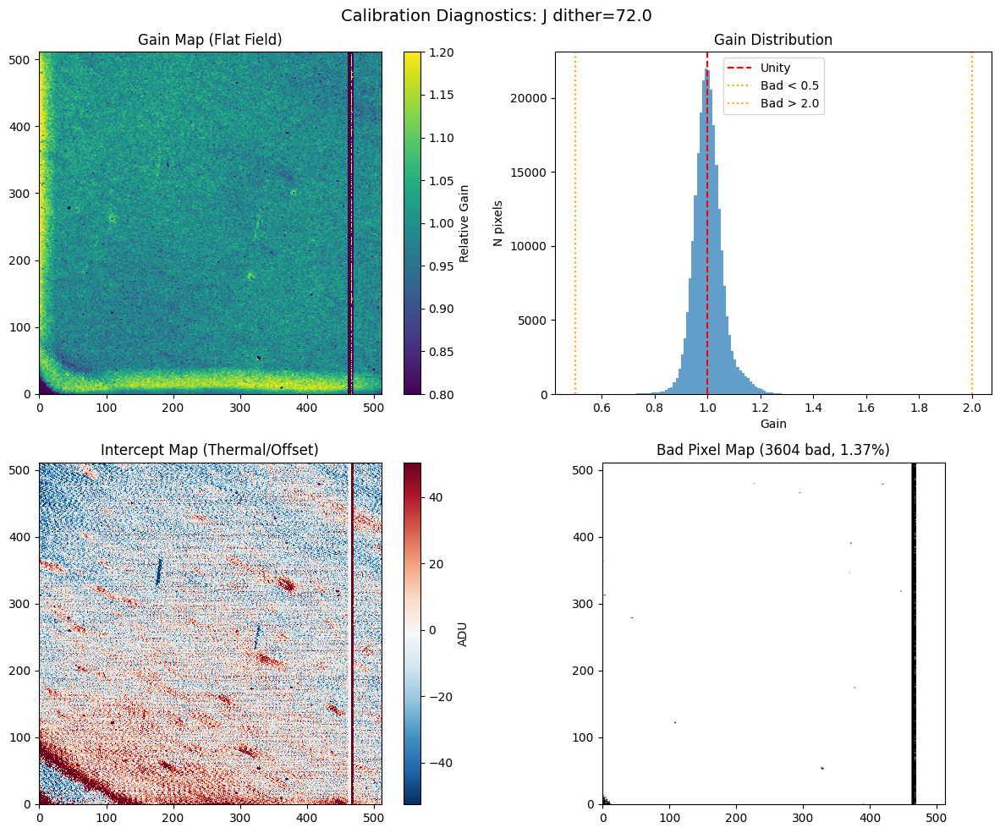


Processing: J dither=288.0 (25 frames)
  Illumination range: 511.0 - 5333.0 ADU
  Processing 512 x 512 pixels...
    Row 0/512
    Row 100/512
    Row 200/512
    Row 300/512
    Row 400/512
    Row 500/512
  Normalized gain map (median was 0.9999)
  Bad pixels: 3832 (1.46%)
  Saved: J_dither288_flat.fits, J_dither288_intercept.fits, J_dither288_badpix.fits


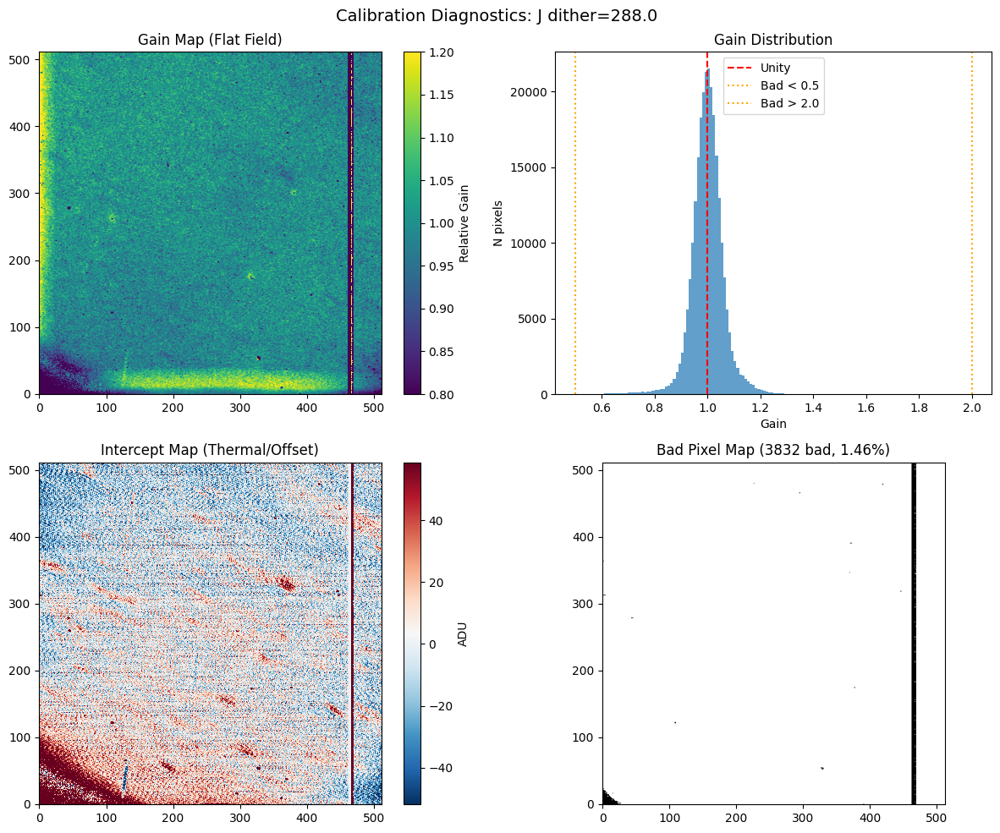


Processing: J dither=216.0 (25 frames)
  Illumination range: 517.0 - 5668.0 ADU
  Processing 512 x 512 pixels...
    Row 0/512
    Row 100/512
    Row 200/512
    Row 300/512
    Row 400/512
    Row 500/512
  Normalized gain map (median was 1.0007)
  Bad pixels: 3640 (1.39%)
  Saved: J_dither216_flat.fits, J_dither216_intercept.fits, J_dither216_badpix.fits


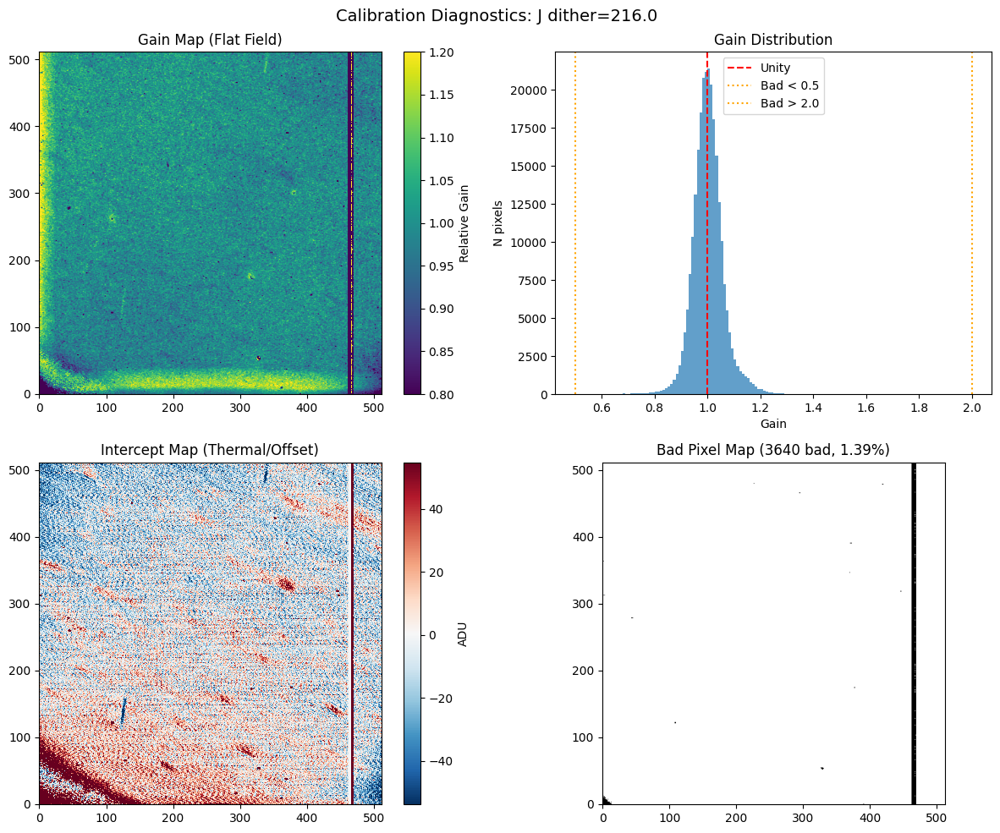


Processing: Z dither=288.0 (25 frames)
  Illumination range: 1673.0 - 9418.0 ADU
  Processing 512 x 512 pixels...
    Row 0/512
    Row 100/512
    Row 200/512
    Row 300/512
    Row 400/512
    Row 500/512
  Normalized gain map (median was 1.0002)
  Bad pixels: 3707 (1.41%)
  Saved: Z_dither288_flat.fits, Z_dither288_intercept.fits, Z_dither288_badpix.fits


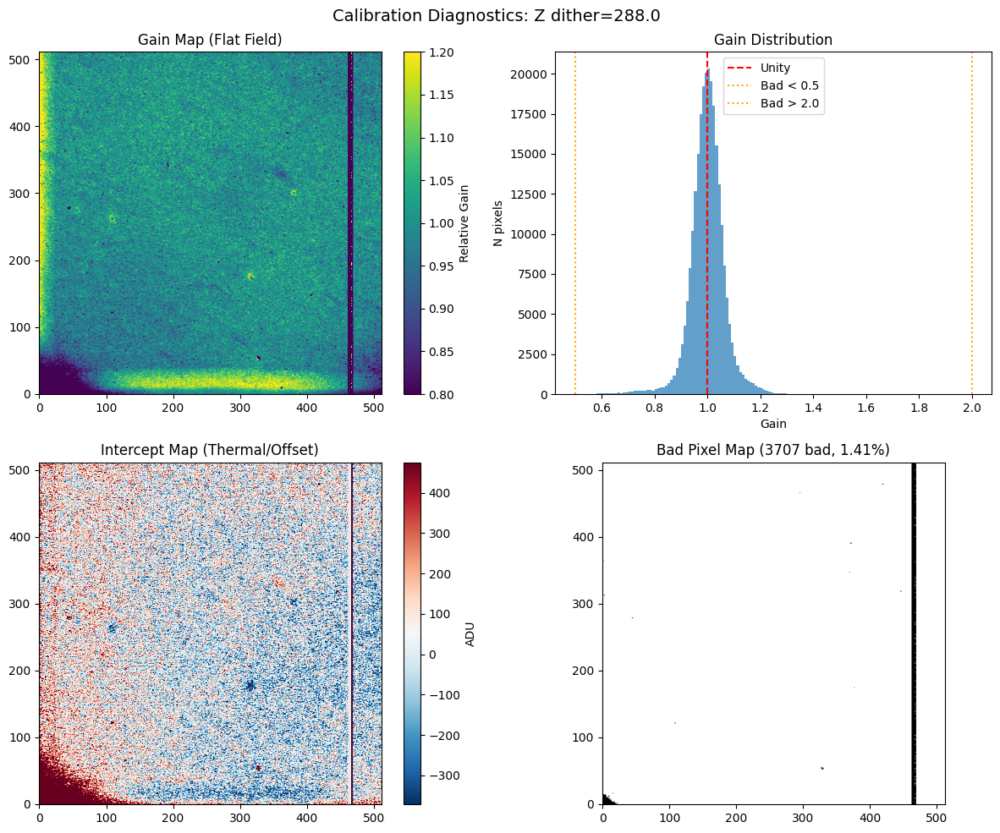


Processing: H2 dither=288.0 (25 frames)
  Illumination range: 7923.0 - 11714.0 ADU
  Processing 512 x 512 pixels...
    Row 0/512
    Row 100/512
    Row 200/512
    Row 300/512
    Row 400/512
    Row 500/512
  Normalized gain map (median was 0.9956)
  Bad pixels: 3536 (1.35%)
  Saved: H2_dither288_flat.fits, H2_dither288_intercept.fits, H2_dither288_badpix.fits


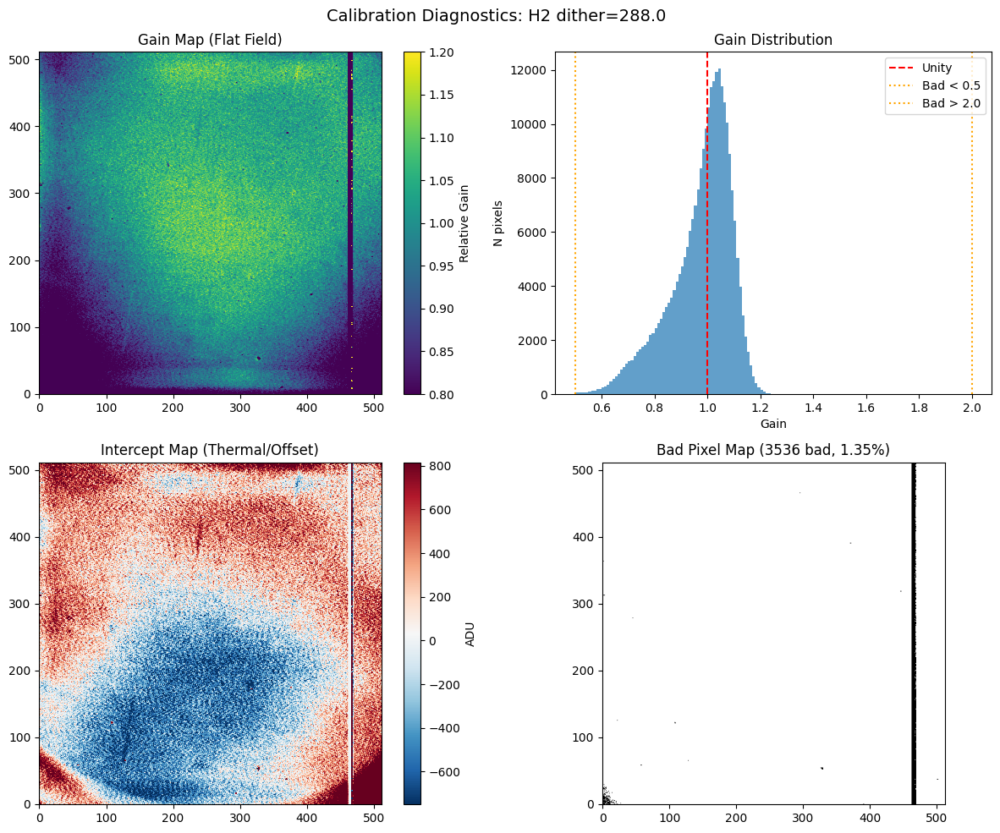


Processing: H2 dither=216.0 (25 frames)
  Illumination range: 7956.0 - 11861.0 ADU
  Processing 512 x 512 pixels...
    Row 0/512
    Row 100/512
    Row 200/512
    Row 300/512
    Row 400/512
    Row 500/512
  Normalized gain map (median was 0.9954)
  Bad pixels: 3506 (1.34%)
  Saved: H2_dither216_flat.fits, H2_dither216_intercept.fits, H2_dither216_badpix.fits


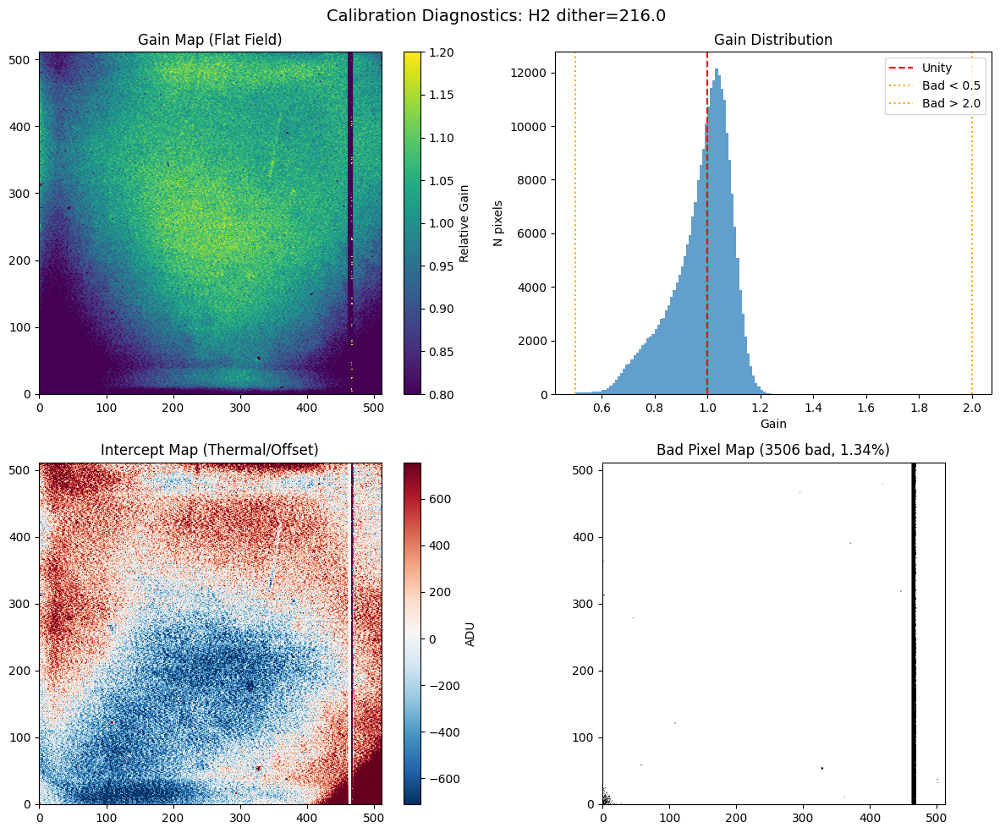


Processing: Z dither=216.0 (25 frames)
  Illumination range: 1690.0 - 9959.0 ADU
  Processing 512 x 512 pixels...
    Row 0/512
    Row 100/512
    Row 200/512
    Row 300/512
    Row 400/512
    Row 500/512
  Normalized gain map (median was 0.9998)
  Bad pixels: 3568 (1.36%)
  Saved: Z_dither216_flat.fits, Z_dither216_intercept.fits, Z_dither216_badpix.fits


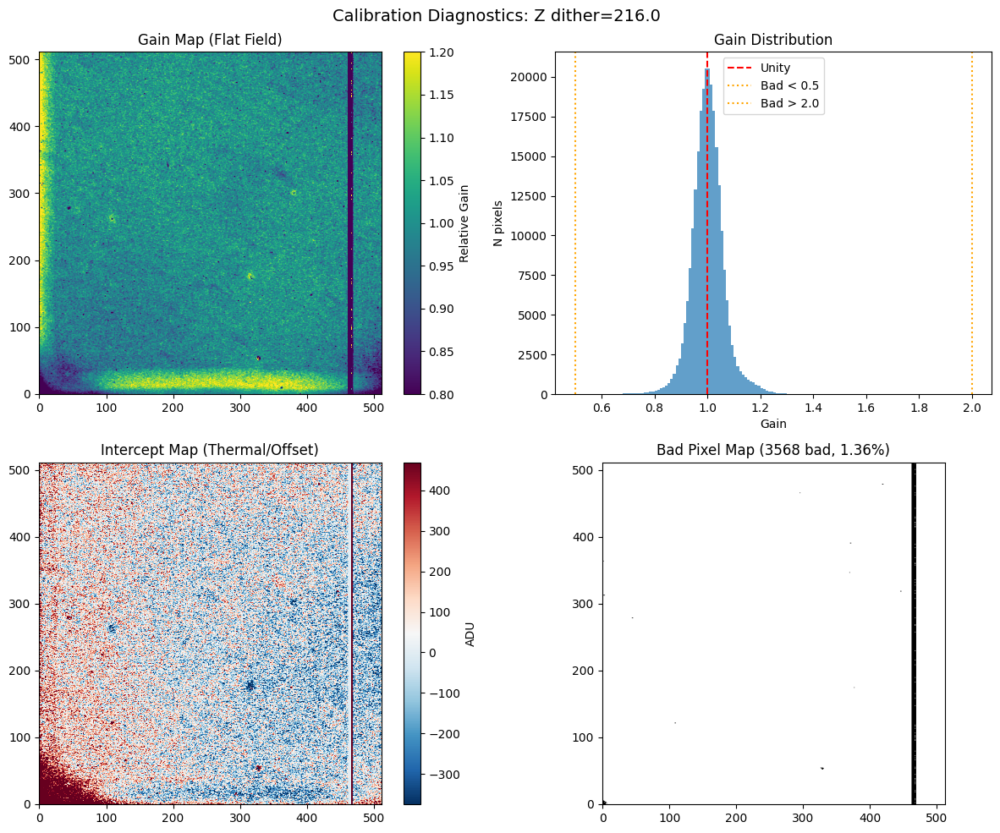


Processing: J dither=0.0 (25 frames)
  Illumination range: 530.0 - 6634.0 ADU
  Processing 512 x 512 pixels...
    Row 0/512
    Row 100/512
    Row 200/512
    Row 300/512
    Row 400/512
    Row 500/512
  Normalized gain map (median was 1.0001)
  Bad pixels: 3804 (1.45%)
  Saved: J_dither0_flat.fits, J_dither0_intercept.fits, J_dither0_badpix.fits


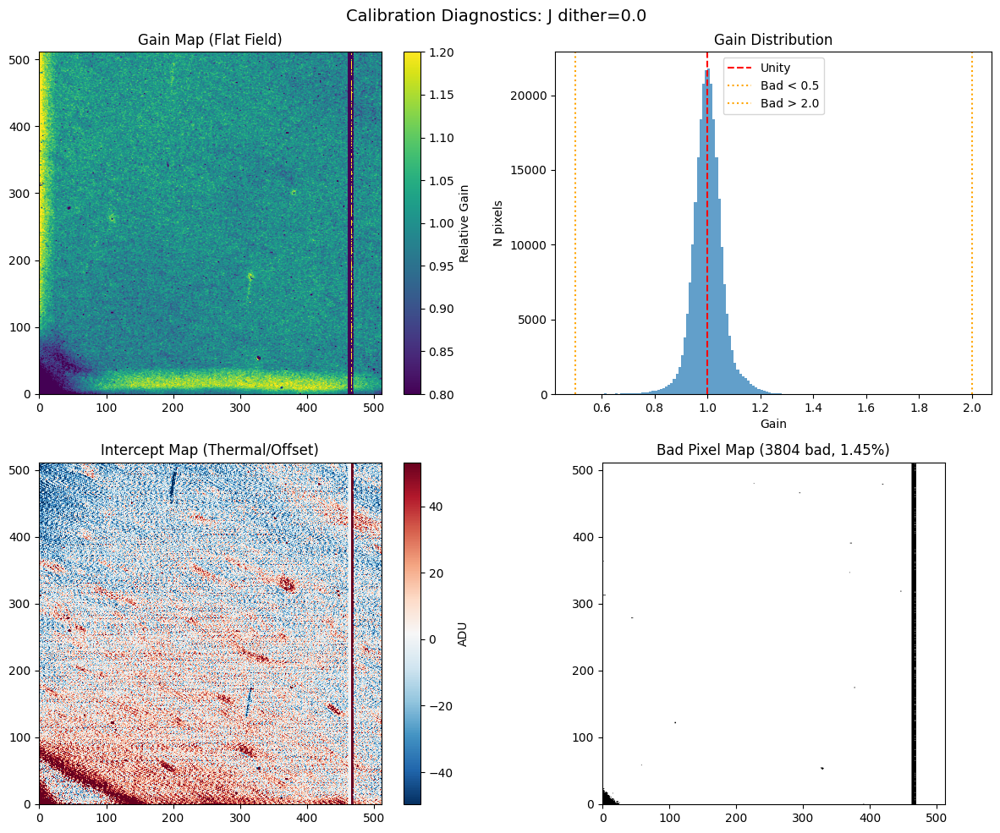


Processing: Z dither=144.0 (25 frames)
  Illumination range: 1698.0 - 10434.0 ADU
  Processing 512 x 512 pixels...
    Row 0/512
    Row 100/512
    Row 200/512
    Row 300/512
    Row 400/512
    Row 500/512
  Normalized gain map (median was 1.0000)
  Bad pixels: 3580 (1.37%)
  Saved: Z_dither144_flat.fits, Z_dither144_intercept.fits, Z_dither144_badpix.fits


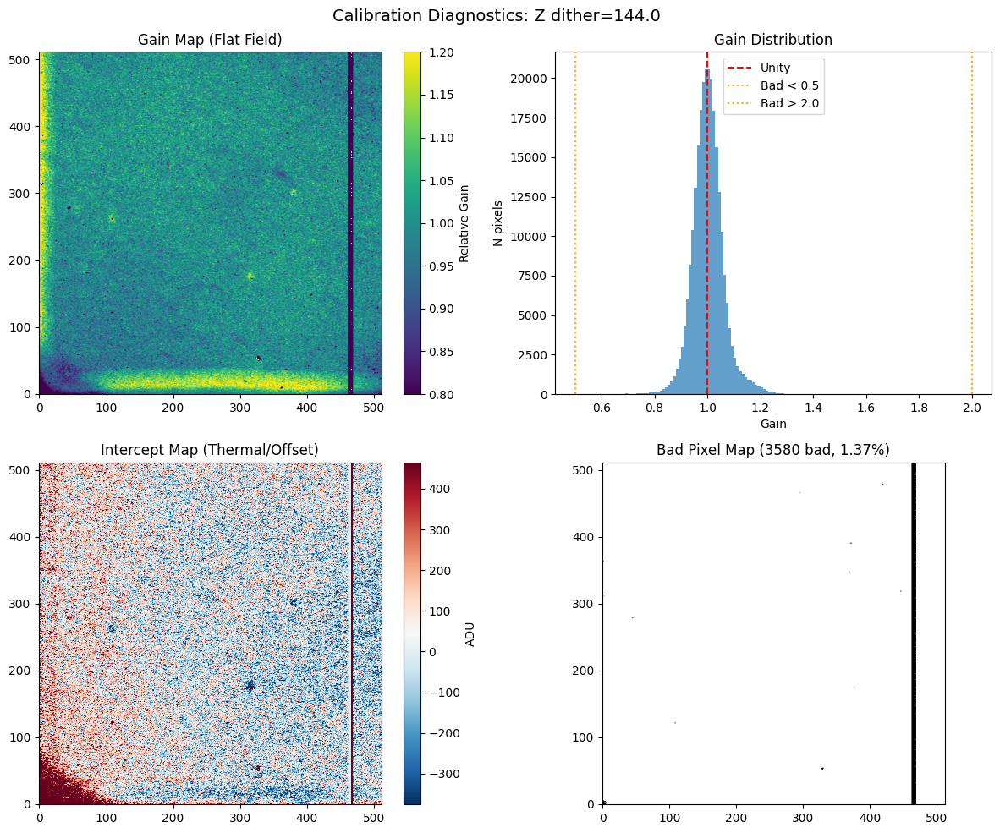


Processing: H2 dither=144.0 (25 frames)
  Illumination range: 8020.0 - 12002.0 ADU
  Processing 512 x 512 pixels...
    Row 0/512
    Row 100/512
    Row 200/512
    Row 300/512
    Row 400/512
    Row 500/512
  Normalized gain map (median was 0.9952)
  Bad pixels: 3492 (1.33%)
  Saved: H2_dither144_flat.fits, H2_dither144_intercept.fits, H2_dither144_badpix.fits


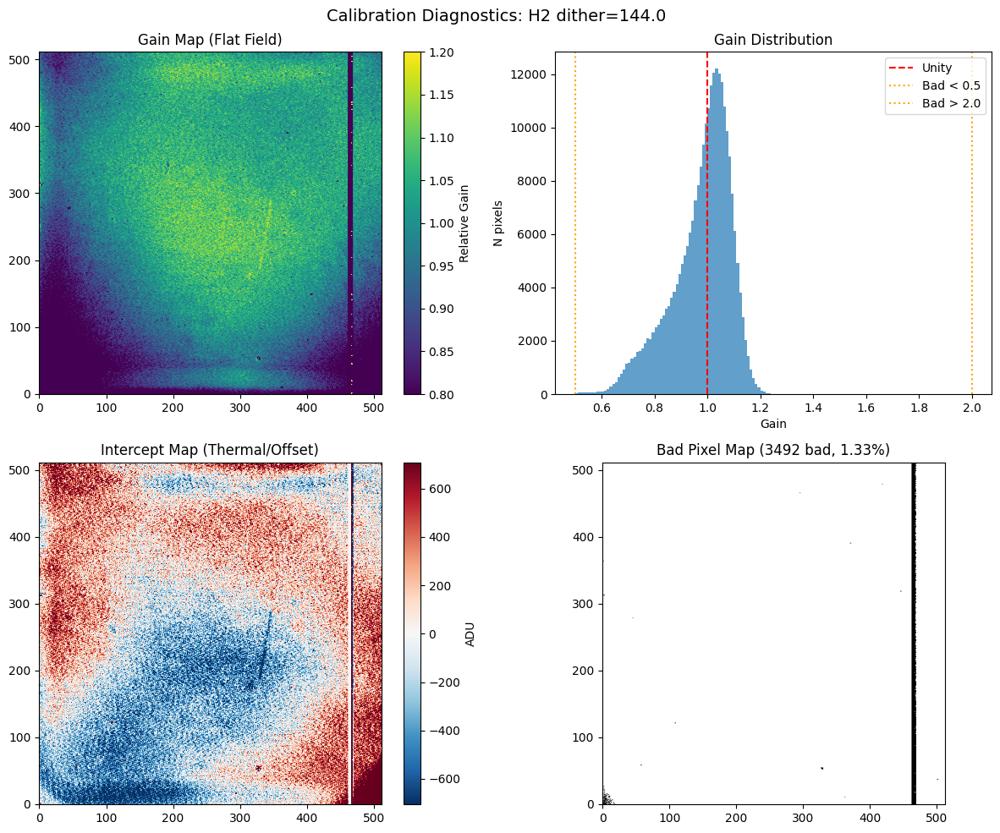


Processing: H2 dither=72.0 (25 frames)
  Illumination range: 8031.0 - 12079.0 ADU
  Processing 512 x 512 pixels...
    Row 0/512
    Row 100/512
    Row 200/512
    Row 300/512
    Row 400/512
    Row 500/512
  Normalized gain map (median was 0.9950)
  Bad pixels: 3476 (1.33%)
  Saved: H2_dither72_flat.fits, H2_dither72_intercept.fits, H2_dither72_badpix.fits


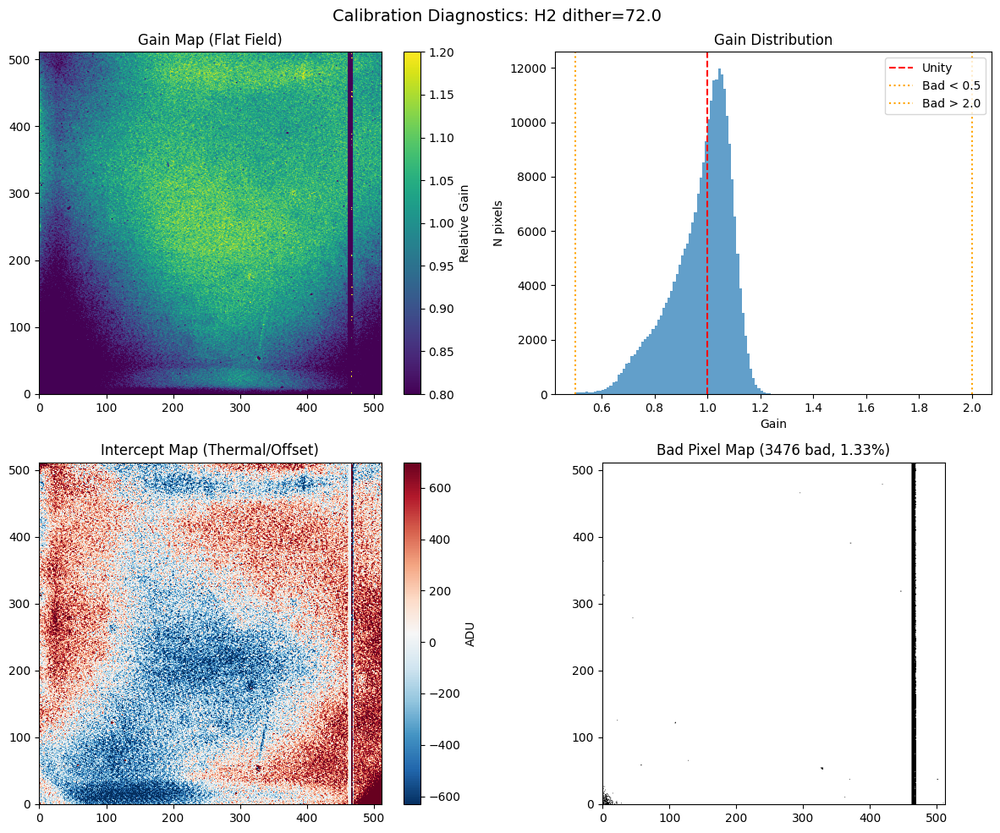


Processing: Z dither=72.0 (25 frames)
  Illumination range: 1702.0 - 10865.0 ADU
  Processing 512 x 512 pixels...
    Row 0/512
    Row 100/512
    Row 200/512
    Row 300/512
    Row 400/512
    Row 500/512
  Normalized gain map (median was 0.9999)
  Bad pixels: 3578 (1.36%)
  Saved: Z_dither72_flat.fits, Z_dither72_intercept.fits, Z_dither72_badpix.fits


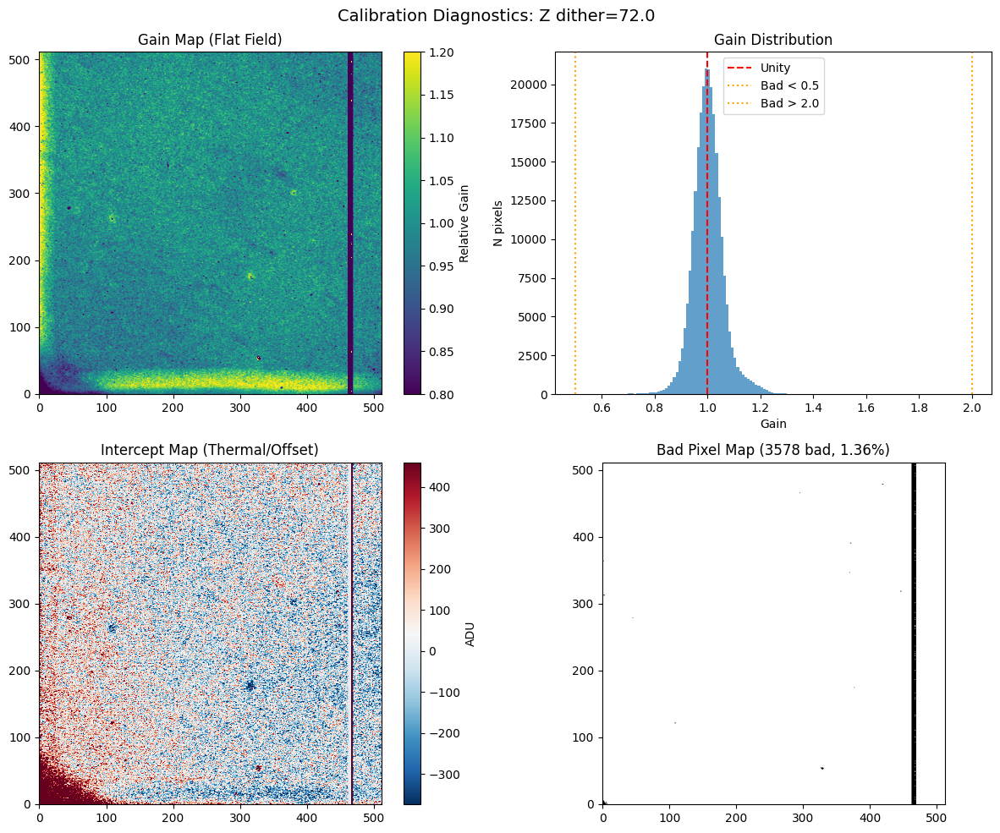


Processing: K dither=144.0 (24 frames)
  Illumination range: 4685.0 - 11046.0 ADU
  Processing 512 x 512 pixels...
    Row 0/512
    Row 100/512
    Row 200/512
    Row 300/512
    Row 400/512
    Row 500/512
  Normalized gain map (median was 0.9997)
  Bad pixels: 6995 (2.67%)
  Saved: K_dither144_flat.fits, K_dither144_intercept.fits, K_dither144_badpix.fits


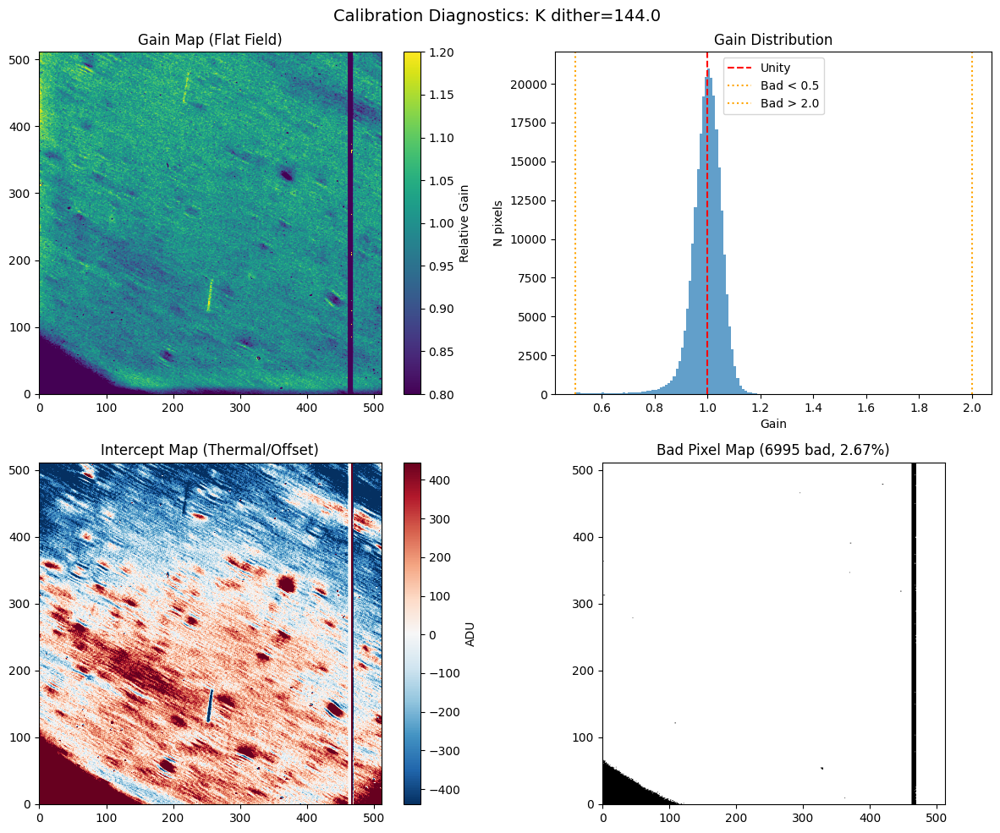


Processing: H dither=288.0 (24 frames)
  Illumination range: 1116.0 - 15103.0 ADU
  Processing 512 x 512 pixels...
    Row 0/512
    Row 100/512
    Row 200/512
    Row 300/512
    Row 400/512
    Row 500/512
  Normalized gain map (median was 0.9996)
  Bad pixels: 5997 (2.29%)
  Saved: H_dither288_flat.fits, H_dither288_intercept.fits, H_dither288_badpix.fits


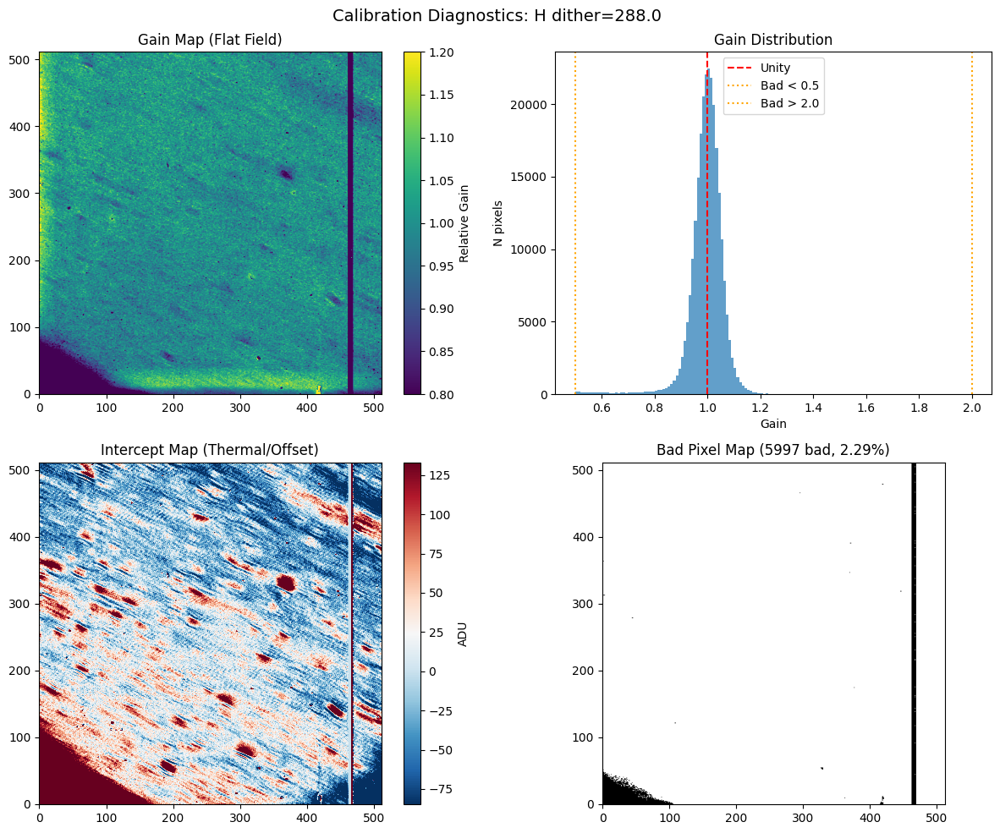


Processing: K dither=216.0 (24 frames)
  Illumination range: 4662.0 - 10570.0 ADU
  Processing 512 x 512 pixels...
    Row 0/512
    Row 100/512
    Row 200/512
    Row 300/512
    Row 400/512
    Row 500/512
  Normalized gain map (median was 0.9997)
  Bad pixels: 7065 (2.70%)
  Saved: K_dither216_flat.fits, K_dither216_intercept.fits, K_dither216_badpix.fits


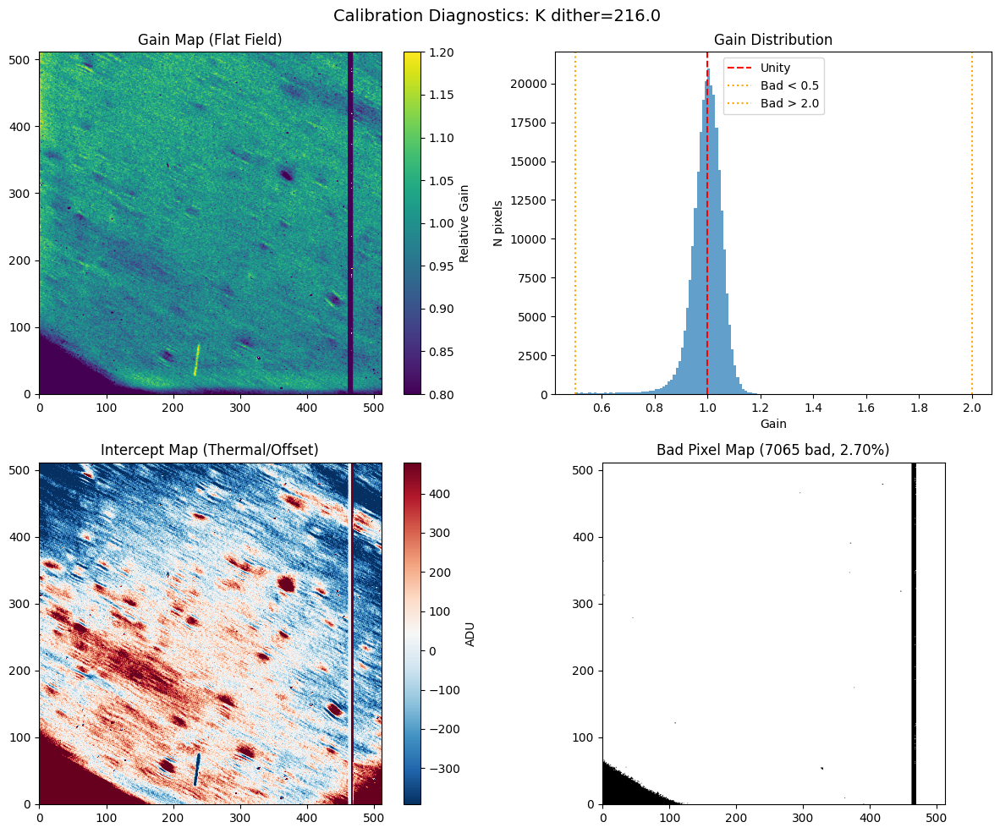


Processing: H dither=216.0 (24 frames)
  Illumination range: 1127.0 - 16223.0 ADU
  Processing 512 x 512 pixels...
    Row 0/512
    Row 100/512
    Row 200/512
    Row 300/512
    Row 400/512
    Row 500/512
  Normalized gain map (median was 0.9995)
  Bad pixels: 4587 (1.75%)
  Saved: H_dither216_flat.fits, H_dither216_intercept.fits, H_dither216_badpix.fits


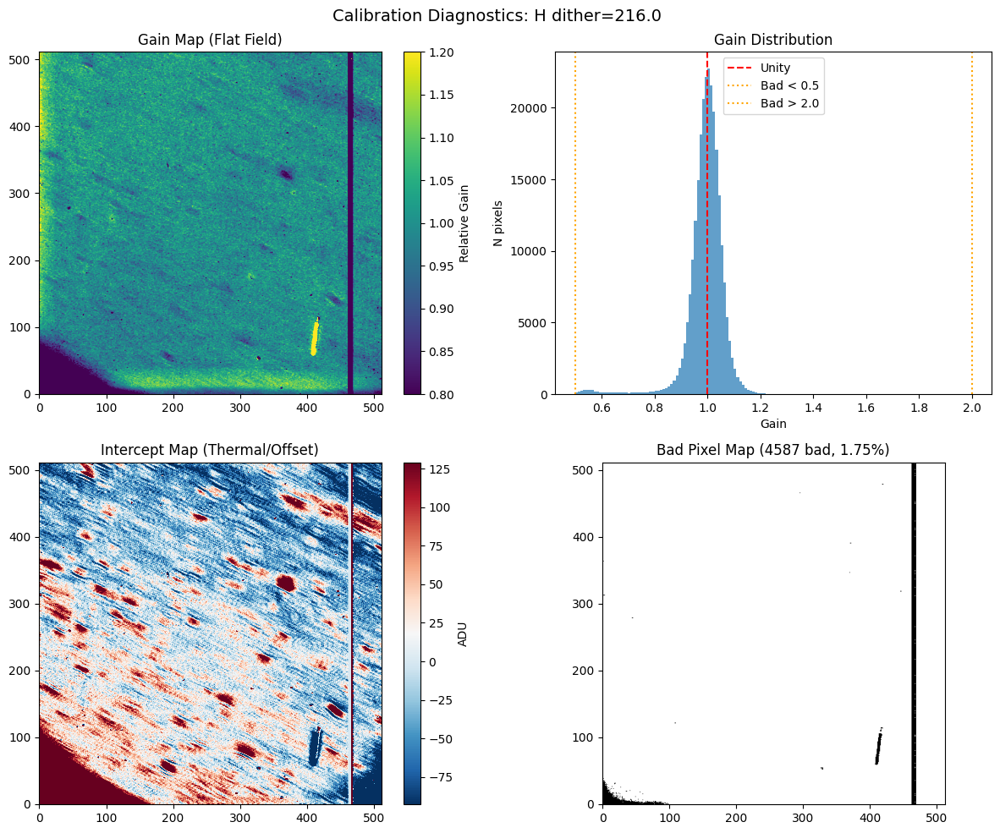


Processing: K dither=288.0 (24 frames)
  Illumination range: 4640.0 - 10102.0 ADU
  Processing 512 x 512 pixels...
    Row 0/512
    Row 100/512
    Row 200/512
    Row 300/512
    Row 400/512
    Row 500/512
  Normalized gain map (median was 1.0006)
  Bad pixels: 7116 (2.71%)
  Saved: K_dither288_flat.fits, K_dither288_intercept.fits, K_dither288_badpix.fits


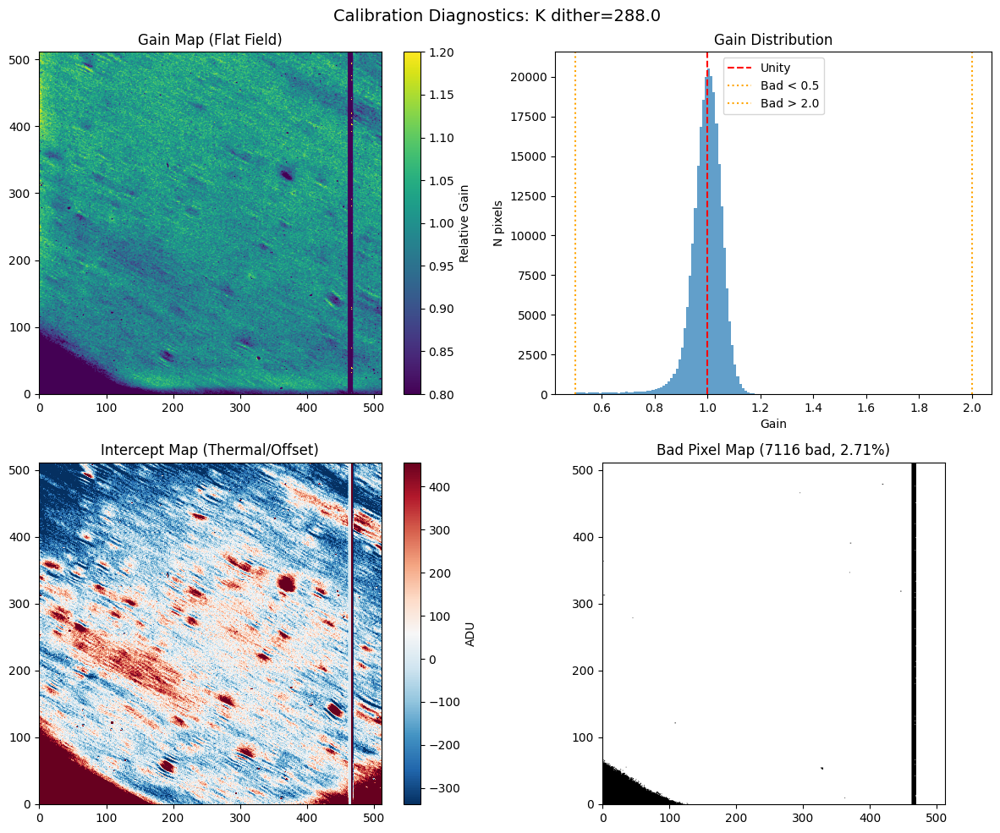


Processing: K dither=72.0 (24 frames)
  Illumination range: 4682.0 - 11490.0 ADU
  Processing 512 x 512 pixels...
    Row 0/512
    Row 100/512
    Row 200/512
    Row 300/512
    Row 400/512
    Row 500/512
  Normalized gain map (median was 1.0001)
  Bad pixels: 7011 (2.67%)
  Saved: K_dither72_flat.fits, K_dither72_intercept.fits, K_dither72_badpix.fits


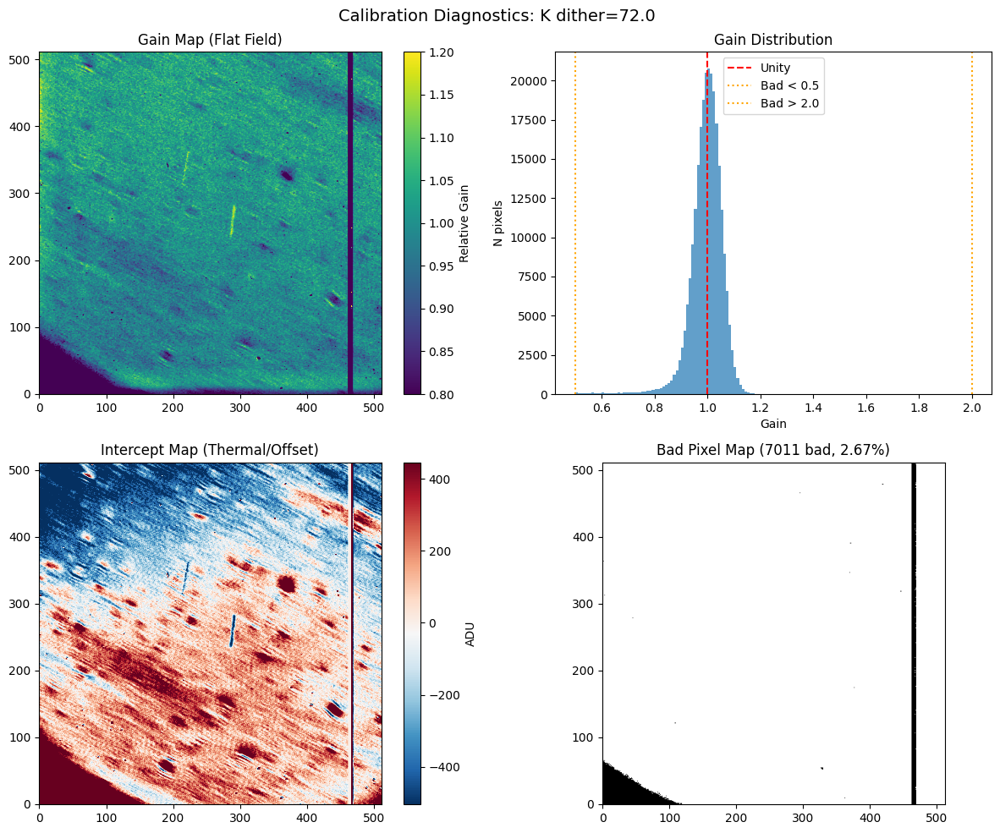


Processing: H dither=144.0 (24 frames)
  Illumination range: 1134.0 - 17342.0 ADU
  Processing 512 x 512 pixels...
    Row 0/512
    Row 100/512
    Row 200/512
    Row 300/512
    Row 400/512
    Row 500/512
  Normalized gain map (median was 0.9997)
  Bad pixels: 4683 (1.79%)
  Saved: H_dither144_flat.fits, H_dither144_intercept.fits, H_dither144_badpix.fits


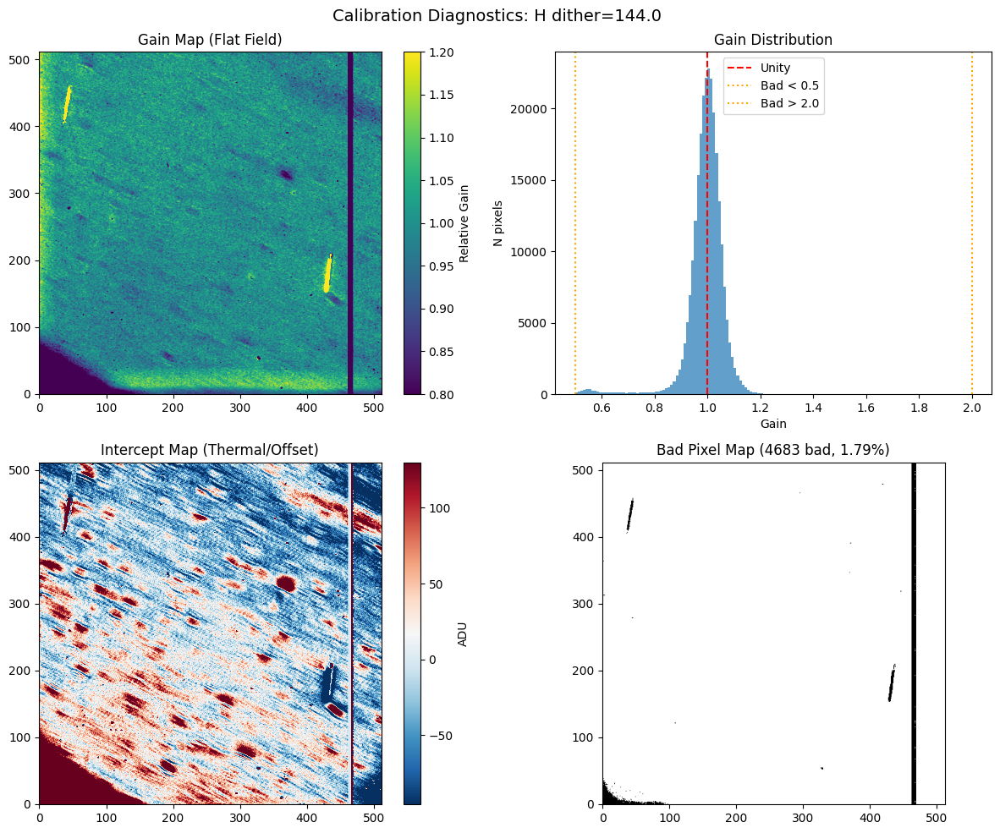


Processing: H dither=72.0 (24 frames)
  Illumination range: 1132.0 - 18448.0 ADU
  Processing 512 x 512 pixels...
    Row 0/512
    Row 100/512
    Row 200/512
    Row 300/512
    Row 400/512
    Row 500/512
  Normalized gain map (median was 0.9996)
  Bad pixels: 4525 (1.73%)
  Saved: H_dither72_flat.fits, H_dither72_intercept.fits, H_dither72_badpix.fits


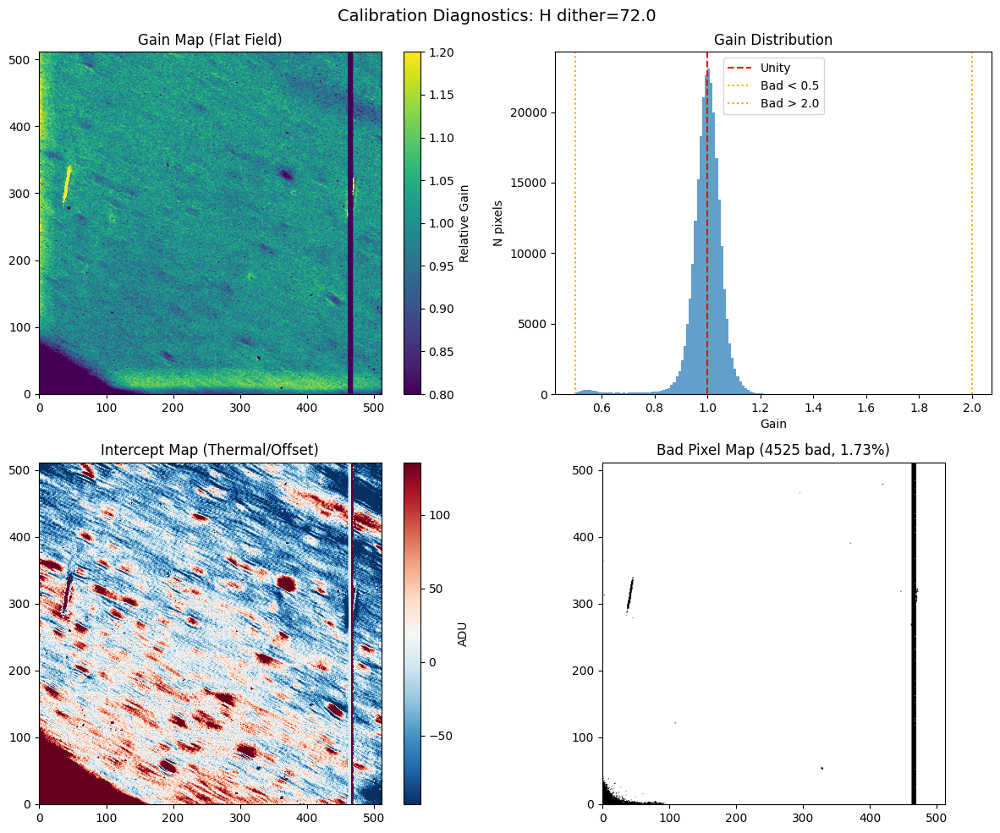


Processing: H dither=0.0 (24 frames)
  Illumination range: 1126.0 - 19499.0 ADU
  Processing 512 x 512 pixels...
    Row 0/512
    Row 100/512
    Row 200/512
    Row 300/512
    Row 400/512
    Row 500/512
  Normalized gain map (median was 0.9998)
  Bad pixels: 6264 (2.39%)
  Saved: H_dither0_flat.fits, H_dither0_intercept.fits, H_dither0_badpix.fits


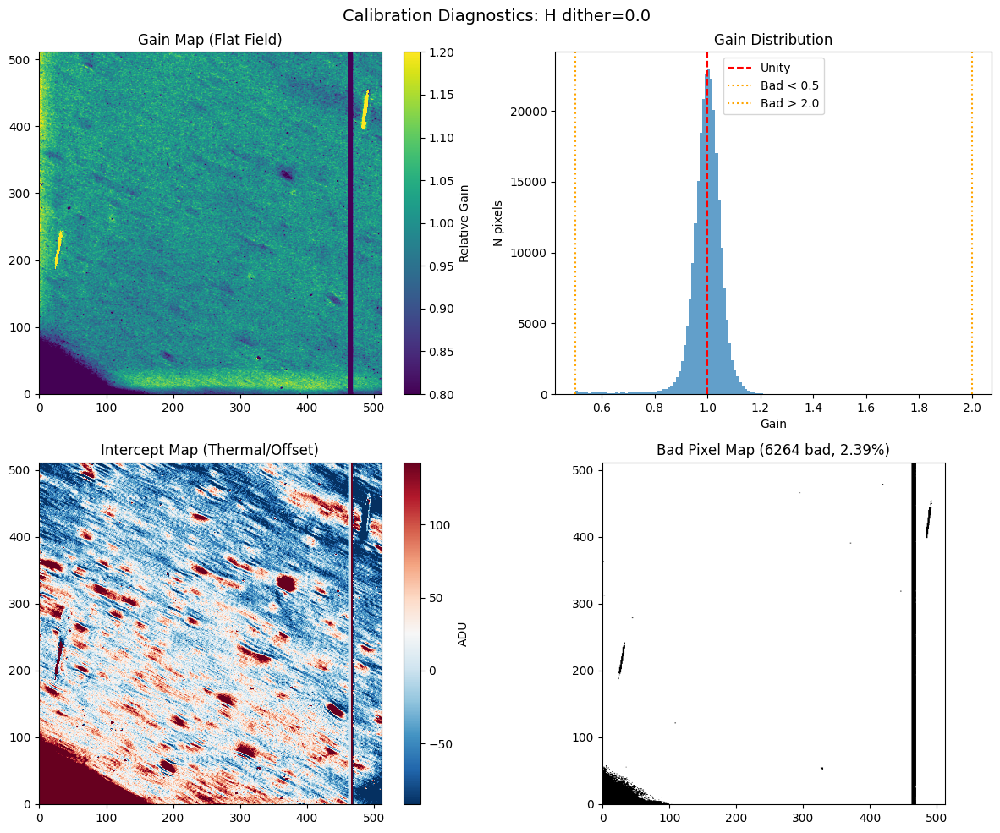


Processing: K dither=0.0 (23 frames)
  Illumination range: 4677.0 - 11902.0 ADU
  Processing 512 x 512 pixels...
    Row 0/512
    Row 100/512
    Row 200/512
    Row 300/512
    Row 400/512
    Row 500/512
  Normalized gain map (median was 1.0002)
  Bad pixels: 7240 (2.76%)
  Saved: K_dither0_flat.fits, K_dither0_intercept.fits, K_dither0_badpix.fits


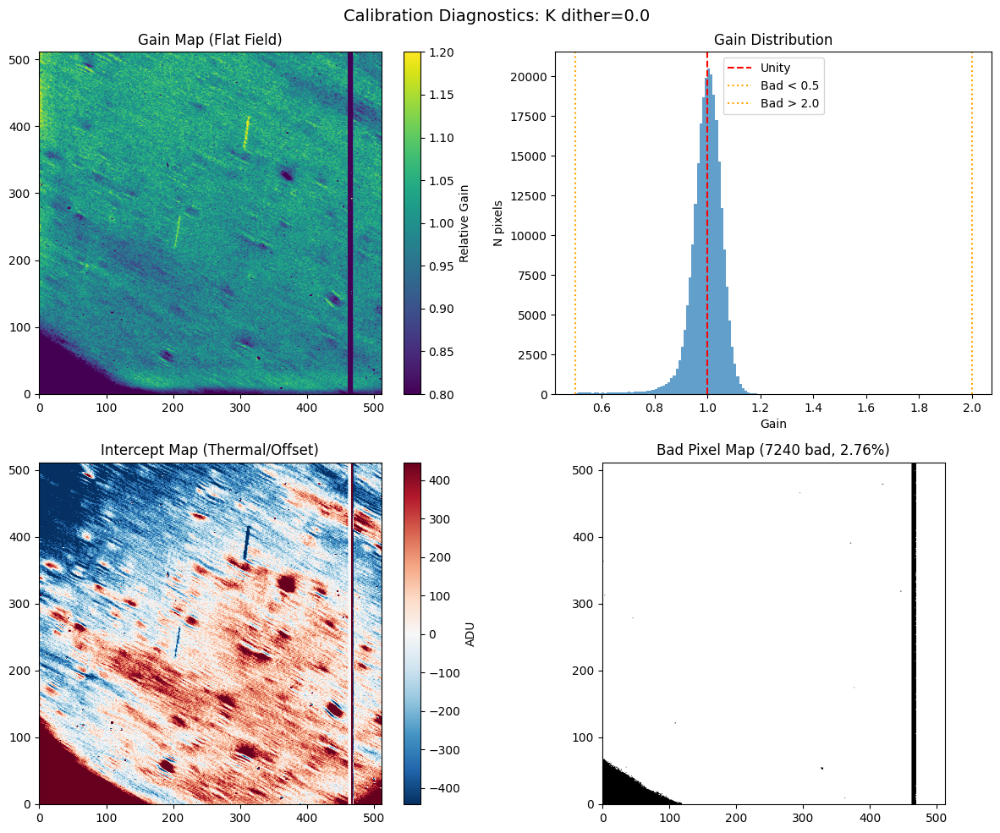


Done! Calibration files saved to: ./calibration_feb/


In [9]:
# ============================================================================
# PART 2: Create Calibration Maps (from cubes or original data)
# ============================================================================

print("=" * 80)
print("PART 2: Creating Calibration Maps")
print("=" * 80)
print(f"Algorithm: {'Proportional (y=ax)' if USE_PROPORTIONAL_FIT else 'Full linear (y=ax+b)'}")
print(f"Gain thresholds: [{GAIN_MIN}, {GAIN_MAX}]")
print(f"Sigma clipping: {SIGMA_CLIP_RESIDUALS}")
print()

# Process each group
print("\n" + "=" * 80)
for (filt, dither), group in flat_groups.items():
    print(f"\nProcessing: {filt} dither={dither} ({len(group)} frames)")
    
    gain, intercept, badpix, n_frames = create_calibration_maps(
        group, 
        use_proportional=USE_PROPORTIONAL_FIT,
        smooth_intercept=SMOOTH_INTERCEPT,
        smooth_scale=SMOOTH_SCALE,
        enforce_positive_intercept=ENFORCE_POSITIVE
    )
    
    if gain is not None:
        # Get reference header from first file
        ref_header = group[0]['header']
        
        # Save files
        save_calibration_files(
            gain, intercept, badpix, 
            filt, dither, n_frames, 
            OUTPUT_FOLDER, ref_header
        )
        
        # Diagnostic plots
        plot_diagnostics(gain, intercept, badpix, filt, dither, OUTPUT_FOLDER)

print("\n" + "=" * 80)
print("Done! Calibration files saved to:", OUTPUT_FOLDER)

Cube shape: (40, 512, 512)
Illumination levels: [4701. 4979. 5019. 5237. 5261. 5307. 5327. 5350. 5362. 5369. 5418. 5422.
 5425. 5448. 5520. 5593. 5702. 5784. 5798. 5839. 6043. 6095. 6140. 6216.
 6388. 6402. 6486. 6504. 6530. 6610. 6617. 6628. 6671. 6745. 6859. 6870.
 6910. 6911. 7353. 7637.]


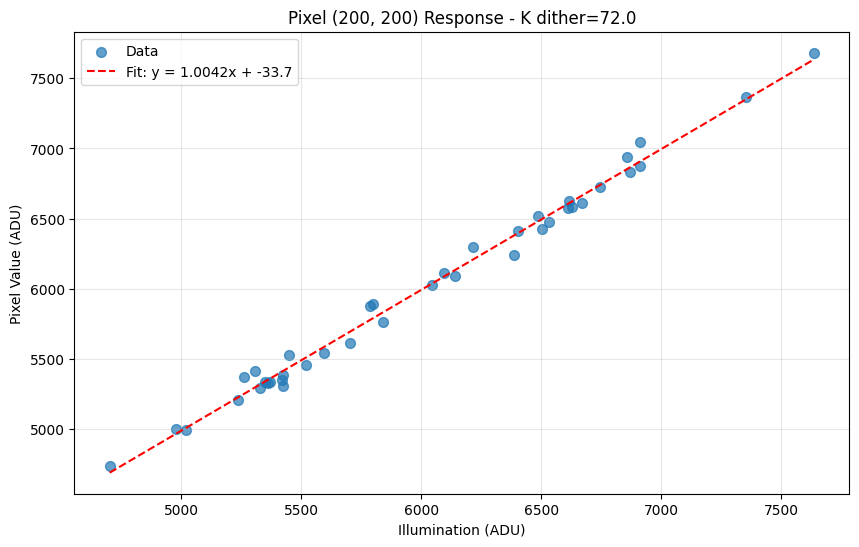

Pixel (200, 200):
  Slope (gain): 1.0042
  Intercept: -33.7 ADU


In [10]:
# ============================================================================
# OPTIONAL: Inspect pixel response vs illumination
# ============================================================================

# Choose filter and dither to inspect
INSPECT_FILTER = 'K'
INSPECT_DITHER = 72.0

# Load cube
cube_file = os.path.join(CUBE_FOLDER, f"{INSPECT_FILTER}_dither{INSPECT_DITHER:.0f}_cube.fits")

with fits.open(cube_file) as hdul:
    data_cube = hdul[0].data
    illum_table = hdul[1].data
    illumination = illum_table['MEDIAN_FLUX']

print(f"Cube shape: {data_cube.shape}")
print(f"Illumination levels: {illumination}")

# Select pixel to inspect (center of detector)
y, x = 200, 200
pixel_values = data_cube[:, y, x]

# Plot pixel response
plt.figure(figsize=(10, 6))
plt.scatter(illumination, pixel_values, alpha=0.7, s=50, label='Data')

# Fit line
slope, intercept, _, _, _ = stats.linregress(illumination, pixel_values)
plt.plot(illumination, slope * illumination + intercept, 'r--', 
         label=f'Fit: y = {slope:.4f}x + {intercept:.1f}')

plt.xlabel('Illumination (ADU)')
plt.ylabel('Pixel Value (ADU)')
plt.title(f'Pixel ({x}, {y}) Response - {INSPECT_FILTER} dither={INSPECT_DITHER}')
plt.legend()
plt.grid(True, alpha=0.3)
plt.show()

print(f"Pixel ({x}, {y}):")
print(f"  Slope (gain): {slope:.4f}")
print(f"  Intercept: {intercept:.1f} ADU")

Creating Master Bad Pixel Mask
Found 25 individual bad pixel maps:
  - H2_dither0_badpix.fits
  - K_dither216_badpix.fits
  - Z_dither216_badpix.fits
  - K_dither144_badpix.fits
  - H_dither72_badpix.fits
  - Z_dither144_badpix.fits
  - K_dither0_badpix.fits
  - H2_dither72_badpix.fits
  - J_dither0_badpix.fits
  - Z_dither0_badpix.fits
  - K_dither288_badpix.fits
  - Z_dither288_badpix.fits
  - H_dither0_badpix.fits
  - H2_dither144_badpix.fits
  - H_dither144_badpix.fits
  - H2_dither216_badpix.fits
  - J_dither72_badpix.fits
  - H_dither216_badpix.fits
  - J_dither144_badpix.fits
  - J_dither216_badpix.fits
  - K_dither72_badpix.fits
  - H2_dither288_badpix.fits
  - H_dither288_badpix.fits
  - Z_dither72_badpix.fits
  - J_dither288_badpix.fits

Bad pixels per individual map:
  H2_dither0_badpix.fits        :   6184 bad ( 2.36%)
  H2_dither144_badpix.fits      :   3654 bad ( 1.39%)
  H2_dither216_badpix.fits      :   3700 bad ( 1.41%)
  H2_dither288_badpix.fits      :   4620 bad ( 1.

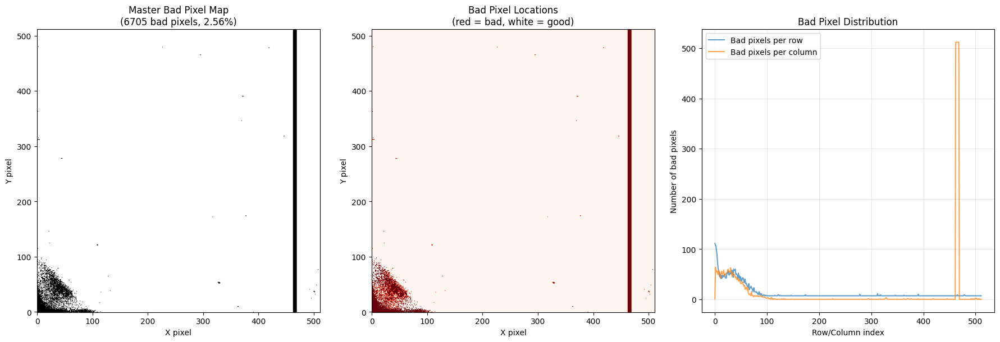

✓ Saved diagnostic plot: ./calibration_new/pixel_mask_diagnostics.png

Master bad pixel mask creation complete!


In [11]:
# ============================================================================
# Create Master Bad Pixel Mask from All Individual Maps
# ============================================================================
# Combines all *_badpix.fits files into a single pixel_mask.fits
# A pixel is marked as bad (0) if it's bad in ANY filter/dither combination

import glob
import os
from astropy.io import fits
import numpy as np

print("=" * 80)
print("Creating Master Bad Pixel Mask")
print("=" * 80)

# Find all individual bad pixel maps
badpix_pattern = os.path.join(OUTPUT_FOLDER, "*_badpix.fits")
badpix_files = glob.glob(badpix_pattern)

print(f"Found {len(badpix_files)} individual bad pixel maps:")
for f in badpix_files:
    print(f"  - {os.path.basename(f)}")

if len(badpix_files) == 0:
    print("\nERROR: No bad pixel maps found!")
    print(f"Pattern searched: {badpix_pattern}")
else:
    # Load first map to get shape
    with fits.open(badpix_files[0]) as hdul:
        shape = hdul[0].data.shape
        master_badpix = np.ones(shape, dtype=np.uint8)  # Start with all good (1)
    
    # Combine all maps (AND operation: pixel is good only if good in ALL maps)
    total_bad_per_map = {}
    for badpix_file in badpix_files:
        with fits.open(badpix_file) as hdul:
            badpix = hdul[0].data
            n_bad = np.sum(badpix == 0)
            total_bad_per_map[os.path.basename(badpix_file)] = n_bad
            
            # Logical AND: keep pixel good (1) only if good in current map
            master_badpix &= badpix  # 0 AND anything = 0
    
    # Statistics
    n_master_bad = np.sum(master_badpix == 0)
    n_total_pixels = master_badpix.size
    
    print(f"\nBad pixels per individual map:")
    for name, n_bad in sorted(total_bad_per_map.items()):
        print(f"  {name:30s}: {n_bad:6d} bad ({100*n_bad/n_total_pixels:5.2f}%)")
    
    print(f"\n{'='*80}")
    print("Master bad pixel map statistics:")
    print(f"{'='*80}")
    print(f"  Total pixels:      {n_total_pixels:8d}")
    print(f"  Bad pixels (0):    {n_master_bad:8d} ({100*n_master_bad/n_total_pixels:5.2f}%)")
    print(f"  Good pixels (1):   {n_total_pixels - n_master_bad:8d} ({100*(n_total_pixels - n_master_bad)/n_total_pixels:5.2f}%)")
    
    # Save master bad pixel map
    master_path = os.path.join(OUTPUT_FOLDER, "pixel_mask.fits")
    hdu = fits.PrimaryHDU(master_badpix)
    hdu.header['PRODUCT'] = 'MASTER_BADPIX'
    hdu.header['BUNIT'] = 'mask'
    hdu.header['MASKCONV'] = '0=bad, 1=good'
    hdu.header['NMAPS'] = len(badpix_files)
    hdu.header['NBAD'] = n_master_bad
    hdu.header['NGOOD'] = n_total_pixels - n_master_bad
    hdu.header['COMMENT'] = 'Combined from all filter/dither bad pixel maps'
    hdu.header['COMMENT'] = 'Pixel is bad (0) if bad in ANY individual map'
    hdu.header['COMMENT'] = 'Created by logical AND of all individual masks'
    hdu.writeto(master_path, overwrite=True)
    
    print(f"\n✓ Saved master mask: {master_path}")
    
    # ========================================================================
    # Diagnostic Plots
    # ========================================================================
    
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))
    
    # Plot 1: Master bad pixel map (0=black/bad, 1=white/good)
    ax = axes[0]
    ax.imshow(master_badpix, origin='lower', cmap='gray', vmin=0, vmax=1)
    ax.set_title(f'Master Bad Pixel Map\n({n_master_bad} bad pixels, {100*n_master_bad/n_total_pixels:.2f}%)')
    ax.set_xlabel('X pixel')
    ax.set_ylabel('Y pixel')
    
    # Plot 2: Bad pixel locations (inverted: red=bad, white=good)
    ax = axes[1]
    bad_locations = (master_badpix == 0).astype(float)
    ax.imshow(bad_locations, origin='lower', cmap='Reds', vmin=0, vmax=1)
    ax.set_title('Bad Pixel Locations\n(red = bad, white = good)')
    ax.set_xlabel('X pixel')
    ax.set_ylabel('Y pixel')
    
    # Plot 3: Histogram of bad pixel counts per row/column
    ax = axes[2]
    bad_per_row = np.sum(master_badpix == 0, axis=1)
    bad_per_col = np.sum(master_badpix == 0, axis=0)
    
    ax.plot(bad_per_row, label='Bad pixels per row', alpha=0.7)
    ax.plot(bad_per_col, label='Bad pixels per column', alpha=0.7)
    ax.set_xlabel('Row/Column index')
    ax.set_ylabel('Number of bad pixels')
    ax.set_title('Bad Pixel Distribution')
    ax.legend()
    ax.grid(True, alpha=0.3)
    
    plt.tight_layout()
    plot_path = os.path.join(OUTPUT_FOLDER, 'pixel_mask_diagnostics.png')
    plt.savefig(plot_path, dpi=150, bbox_inches='tight')
    plt.show()
    
    print(f"✓ Saved diagnostic plot: {plot_path}")
    
    print("\n" + "=" * 80)
    print("Master bad pixel mask creation complete!")
    print("=" * 80)